In [1]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import box, LineString
import altair as alt
from pathlib import Path

alt.data_transformers.enable("vegafusion")

CWD = Path.cwd()
data_folder = CWD.parent / "compiled_results" / "all"

In [2]:
color_scale = {
    "policy": {"domain": ["Net-zero", "Current"], "range": ["#1f77b4", "#ff7f0e"]},
    "CCS": {"domain": ["Allowed", "Not Allowed"], "range": ["#17becf", "#bcbd22"]},
    "retirement": {"domain": ["Age", "Economic"], "range": ["#8c564b", "#2ca02c"]}, #["#9467bd", "#8c564b"]},
    "dispatch": {
        "domain": ["Simplified", "Unit Commit"],
        "range": ["#e377c2", "#7f7f7f"],
    },
    "transmission_constraint": {
        "domain": ["No Expansion", "High", "Moderate", "Unconstrained"],
        "range": ["#4c72b0", "#de4d4a", "#8172b3", "#55a868"],
    },
}

In [3]:
def fill_idx(df: pd.DataFrame, cols) -> pd.DataFrame:
    midx = pd.MultiIndex.from_product([df[c].unique() for c in cols], names=cols)
    df = df.set_index(cols)
    df = df.reindex(midx, fill_value=0)
    return df.reset_index()


def var_to_none(var):
    if var == "None":
        return None
    return var

## Load data

In [4]:
emiss = pd.read_csv(data_folder / "emissions.csv")
emiss["value"] /= 1e6
emiss.loc[emiss["model"] == "Temoa", "model"] = "TEMOA"
emiss.head()

,model,zone,planning_year,case,unit,value,agg_zone,scenario,configuration,child_scenario
0,GenX,BASN,2027,20-week-foresight,tons,24.6795,WECC,base,foresight,none
1,GenX,CANO,2027,20-week-foresight,tons,15.7647,CA,base,foresight,none
2,GenX,CASO,2027,20-week-foresight,tons,15.1280,CA,base,foresight,none
3,GenX,FRCC,2027,20-week-foresight,tons,71.9512,SOU,base,foresight,none
4,GenX,ISNE,2027,20-week-foresight,tons,27.3940,NE,base,foresight,none


In [5]:
emiss.child_scenario.unique()

array(['none', 'carbon_price', 'ccs', 'transmission'], dtype=object)

In [6]:
emiss["CCS"] = "Allowed"
emiss.loc[emiss["child_scenario"] == "ccs", "CCS"] = "Not Allowed"


emiss["transmission_constraint"] = "Unconstrained"
emiss.loc[emiss["case"] == "full-base-200-tx-0", "transmission_constraint"] = (
    "No Expansion"
)
emiss.loc[emiss["case"] == "full-base-200-tx-15", "transmission_constraint"] = "High"
emiss.loc[emiss["case"] == "full-base-200-tx-50", "transmission_constraint"] = (
    "Moderate"
)

emiss["carbon_price"] = "$200"
emiss.loc[emiss["case"] == "full-base-50", "carbon_price"] = "$50"
emiss.loc[emiss["case"] == "full-base-1000", "carbon_price"] = "$1000"
emiss.loc[emiss["case"].str.contains("current"), "carbon_price"] = None

emiss["carbon_price_size"] = 25
emiss.loc[emiss["case"].str.contains("current"), "carbon_price_size"] = 0

emiss["width"] = 10
emiss.loc[emiss["case"] == "full-base-200", "width"] = 11

emiss["policy"] = "Net-zero"
emiss.loc[emiss["scenario"] == "current_policies", "policy"] = "Current"

In [7]:
costs = pd.read_csv(data_folder / "operational_costs_model.csv")
costs.loc[costs["model"] == "Temoa", "model"] = "TEMOA"
costs["Total"] /= 1e9
costs["transmission_constraint"] = "Unconstrained"
costs.loc[costs["case"] == "full-base-200-tx-0", "transmission_constraint"] = (
    "No Expansion"
)
costs.loc[costs["case"] == "full-base-200-tx-15", "transmission_constraint"] = "High"
costs.loc[costs["case"] == "full-base-200-tx-50", "transmission_constraint"] = (
    "Moderate"
)

costs["CCS"] = "Allowed"
costs.loc[costs["child_scenario"] == "ccs", "CCS"] = "Not Allowed"

costs.head()

,Costs,Total,Zone1,Zone2,Zone3,Zone4,Zone5,Zone6,Zone7,Zone8,...,Zone26,planning_year,model,percent_total,case,configuration,scenario,child_scenario,transmission_constraint,CCS
0,cFix,68.909863,3.1021920731e9,9.178273785699999e8,8.504408434200002e8,1.79536302151e9,1.9067363609400003e9,3.25709846882e9,1.2512360326e9,2.2683812396600003e9,...,1.5489742915599997e9,2027,GenX,0.5,20-week-foresight,foresight,base,none,Unconstrained,Allowed
1,cVar,53.645614,8.545692351800573e8,1.4848469347315748e9,1.3912612084995527e9,5.891189962555871e9,1.8774360524864488e9,1.5535423889566097e9,1.7209082975988421e9,3.5362252564337325e9,...,3.9565862774954e8,2027,GenX,0.4,20-week-foresight,foresight,base,none,Unconstrained,Allowed
2,cNSE,0.150705,23188.586751708797,23198.8778826584,23205.377061910574,23651.44172047726,8.693696445477767e7,23176.143473271663,23213.502956306045,23377.283087875665,...,23191.388934614566,2027,GenX,0.0,20-week-foresight,foresight,base,none,Unconstrained,Allowed
3,cStart,0.457850,5.967970551772845e6,1.5591307008334314e6,4.983314231332034e6,3.9348302310726037e6,7.0109069627544405e6,3.109294686093279e7,3.4537183693502387e6,1.2777382837330889e7,...,1.7468695097488213e7,2027,GenX,0.0,20-week-foresight,foresight,base,none,Unconstrained,Allowed
4,cUnmetRsv,0.000000,-,-,-,-,-,-,-,-,...,-,2027,GenX,0.0,20-week-foresight,foresight,base,none,Unconstrained,Allowed


In [8]:
costs["Dispatch"] = "Simplified"
costs.loc[costs["case"].str.contains("commit"), "Dispatch"] = "Unit Commit"

costs["Periods"] = "52 weeks"
costs.loc[costs["case"].str.contains("20-week"), "Periods"] = "20 weeks"

costs["Retirement"] = "Age"
costs.loc[costs["case"].str.contains("retire"), "Retirement"] = "Economic"

costs["Investment"] = "Myopic"
costs.loc[costs["case"].str.contains("foresight"), "Investment"] = "Foresight"

costs["policy"] = "Net-zero"
costs.loc[costs["scenario"] == "current_policies", "policy"] = "Current"

In [9]:
cap = pd.read_parquet(data_folder / "capacity.parquet")
cap["Retirement"] = "Age"
cap.loc[cap["case"].str.contains("retire"), "Retirement"] = "Economic"
cap["CCS"] = "Allowed"
cap.loc[cap["child_scenario"] == "ccs", "CCS"] = "Not Allowed"

cap["policy"] = "Net-zero"
cap.loc[cap["scenario"] == "current_policies", "policy"] = "Current"

In [10]:
gen = pd.read_parquet(data_folder / "generation.parquet")
gen["Retirement"] = "Age"
gen.loc[gen["case"].str.contains("retire"), "Retirement"] = "Economic"
gen["CCS"] = "Allowed"
gen.loc[gen["child_scenario"] == "ccs", "CCS"] = "Not Allowed"

gen["policy"] = "Net-zero"
gen.loc[gen["scenario"] == "current_policies", "policy"] = "Current"

In [11]:
tx_data = pd.read_csv(data_folder / "annual_tx_expansion.csv")
tx_data.head()

,model,line,line_name,planning_year,case,unit,value,end_value,start_region,dest_region,km,end_cap,start_cap,scenario,configuration,child_scenario,cap
0,GenX,1.0,BASN_to_CANO,2023,20-week-foresight,MW,161338.0,163129.0,BASN,CANO,1613.384713,101.11,100.0,base,foresight,none,NaN
1,GenX,2.0,BASN_to_CASO,2023,20-week-foresight,MW,6232667.0,6232730.0,BASN,CASO,1052.815400,5920.06,5920.0,base,foresight,none,NaN
2,GenX,3.0,BASN_to_NWPP,2023,20-week-foresight,MW,7181335.0,7181785.0,BASN,NWPP,2143.682033,3350.21,3350.0,base,foresight,none,NaN
3,GenX,4.0,BASN_to_RMRG,2023,20-week-foresight,MW,5546133.0,5548706.0,BASN,RMRG,1478.968740,3751.74,3750.0,base,foresight,none,NaN
4,GenX,5.0,BASN_to_SRSG,2023,20-week-foresight,MW,6445229.0,6445241.0,BASN,SRSG,1196.885695,5385.01,5385.0,base,foresight,none,NaN


In [12]:
tx_data["CCS"] = "Allowed"
tx_data.loc[tx_data["child_scenario"] == "ccs", "CCS"] = "Not Allowed"

tx_data["policy"] = "Net-zero"
tx_data.loc[tx_data["scenario"] == "current_policies", "policy"] = "Current"

In [13]:
tx_exp = pd.read_csv(data_folder / "annual_tx_expansion.csv")

## Figures

### Figure 1

In [14]:
small_width = 65
small_height = 58
large_width = 170
large_height = 120

In [15]:
cases = ["full-base-200", "full-current-policies"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

cap_data = (
    cap.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "policy",
        ],
        as_index=False,
    )["end_value"]
    .sum()
)
cap_data["end_value"] /= 1000

cap_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=True).title("Capacity (GW)"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(end_value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")#.scale(domain=["Capacity"], range=["circle"])
    )
    .properties(height=small_height, width=small_width)
    # .resolve_scale("independent")
)

In [16]:
chart_list = []
chart_list.append(
    alt.layer(
        cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
        ),
        data=cap_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Nuclear']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Capacity")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title(None),
        ),
        data=cap_data.query("tech_type in ['CCS', 'Solar', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
scenario_cap_chart = alt.hconcat(*chart_list, spacing=3).properties(title="Capacity")
scenario_cap_chart

ImportError: The "vegafusion" data transformer and chart.transformed_data feature requires
version 1.5.0 or greater of the 'vegafusion-python-embed' and 'vegafusion' packages.
These can be installed with pip using:
    pip install "vegafusion[embed]>=1.5.0"
Or with conda using:
    conda install -c conda-forge "vegafusion-python-embed>=1.5.0" "vegafusion>=1.5.0"

ImportError: No module named 'vegafusion'

alt.HConcatChart(...)

In [17]:
cases = ["full-base-200", "full-current-policies"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

gen_data = (
    gen.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "policy",
        ],
        as_index=False,
    )["value"]
    .sum()
)
gen_data["value"] /= 1000000
# data = fill_idx(data, ["case", "model", "tech_type"])
gen_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=True).title("Generation (TWh)"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")
    )
    .properties(height=small_height, width=small_width)
)

In [18]:
chart_list = []
chart_list.append(
    alt.layer(
        gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title("TWh"),
        ),
        data=gen_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Nuclear']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title(None),
        ),
        data=gen_data.query("tech_type in ['CCS', 'Solar', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
scenario_gen_chart = alt.hconcat(*chart_list, spacing=3).properties(title="Generation")
scenario_gen_chart

ImportError: The "vegafusion" data transformer and chart.transformed_data feature requires
version 1.5.0 or greater of the 'vegafusion-python-embed' and 'vegafusion' packages.
These can be installed with pip using:
    pip install "vegafusion[embed]>=1.5.0"
Or with conda using:
    conda install -c conda-forge "vegafusion-python-embed>=1.5.0" "vegafusion>=1.5.0"

ImportError: No module named 'vegafusion'

alt.HConcatChart(...)

In [19]:
cap_gen_chart = (
    alt.hconcat(scenario_cap_chart, scenario_gen_chart, spacing=3)
    # .configure_header(title=None)
    # .configure_title(align="center", anchor="middle")
    # .configure_legend(orient="bottom")
)
cap_gen_chart

ImportError: The "vegafusion" data transformer and chart.transformed_data feature requires
version 1.5.0 or greater of the 'vegafusion-python-embed' and 'vegafusion' packages.
These can be installed with pip using:
    pip install "vegafusion[embed]>=1.5.0"
Or with conda using:
    conda install -c conda-forge "vegafusion-python-embed>=1.5.0" "vegafusion>=1.5.0"

ImportError: No module named 'vegafusion'

alt.HConcatChart(...)

In [21]:
cases = ["full-base-200", "full-current-policies"]
x_var = "planning_year"
color = "policy"
dash = "model"
facet_col = None
n_cols = 10
col_var = "case"
row_var = None
x_var = var_to_none(x_var)
col_var = var_to_none(col_var)
row_var = var_to_none(row_var)
color = var_to_none(color)
dash = var_to_none(dash)

group_by = []
_tooltips = [
    alt.Tooltip("sum(end_value)", format=",.0f", title="Period GW-km"),
]

for var in [x_var, col_var, row_var, color, dash, "planning_year"]:
    if var is not None:
        group_by.append(var)
        _tooltips.append(alt.Tooltip(var))
if tx_data[x_var].nunique() < 4:
    width = 80
tx_data["line_name"] = tx_data["line_name"].str.replace("_to_", " | ")

data = tx_data.groupby(list(set(group_by)), as_index=False)[
    ["value", "end_value"]
].sum()


if not (col_var is None and row_var is None) and 2023 in data["planning_year"].unique():
    first_year = data["planning_year"].min()
    idx_cols = [c for c in [facet_col, col_var, row_var] if c is not None]
    data = data.set_index(idx_cols)
    first_data = data.query("planning_year == @first_year")
    df_list = []
    for year in data["planning_year"].unique():
        prev_years = (
            data.query("planning_year < @year")
            .groupby(idx_cols)[["value", "end_value"]]
            .sum()
        )
        _df = data.query("planning_year == @year")
        if year == first_year:
            _df["line_growth"] = 0
            # df_list.append(_df)
        else:
            try:
                # _df["line_growth"] = (_df["value"] / first_data["value"]).fillna(0)
                _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
            except:
                _df["line_growth"] = 0
        df_list.append(_df)
    data = pd.concat(df_list).reset_index()
    # if not (col_var is None and row_var is None):
    _tooltips.append(alt.Tooltip("line_growth", title="Period Growth", format=".0%"))

data["value"] /= 1000000
# return data

# data = data.rename(columns=VAR_ABBR_MAP)
data["cum_value"] = data.groupby(["model", "case"])[["value"]].cumsum()
tx_chart = (
    alt.Chart(data.reset_index().query("case in @cases"))
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(cum_value)").title("TW-km"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        tooltip=_tooltips,
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
    )
    .properties(height=large_height, width=large_width, title="Transmission")
)
tx_chart

# return chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/58339346.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/58339346.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/58339346.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

alt.Chart(...)

In [22]:
cases = ["full-base-200", "full-current-policies"]

data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
cost_lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=True).title("Billion $"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=large_height, width=large_width, title="Costs")
)

# color_domain = ["Foresight", "Myopic"]
# color_range = ["red", "black"]
# points = alt.Chart().mark_point(filled=True).encode(
#     x=alt.X("planning_year").axis(format="04d").title(None),
#     y=alt.Y("sum(Total)").scale(zero=False).title("Operational Costs (Billion $)"),
#     # opacity="Investment",
#     fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
#     detail="case",
#     shape="Periods",
#     tooltip=["case"]
# )#.properties(height=300, width=275)

cost_lines

# chart = alt.layer(lines, points, data=data.sort_values("Investment", ascending=False)).facet(column="model") #, row="configuration")
# # chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
# chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/179691904.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.Chart(...)

In [23]:
tx_cost_chart = alt.hconcat(tx_chart, cost_lines, spacing=3)
tx_cost_chart

alt.HConcatChart(...)

In [ ]:
tx_cost_chart = alt.hconcat(tx_chart, cost_lines, spacing=3)
tx_cost_chart

alt.HConcatChart(...)

In [24]:
paper_policy_chart = (
    alt.vconcat(cap_gen_chart, tx_cost_chart, center=True, spacing=5)
    .configure_header(title=None)
    .configure_title(align="center", anchor="middle") # anchor="start")
    .configure_legend(
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2
)
)
paper_policy_chart

alt.VConcatChart(...)

In [ ]:
paper_policy_chart.save("paper_policy_results.png")
paper_policy_chart.save("paper_policy_results.pdf", format="pdf")

In [245]:
paper_policy_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None).configure_title(fontSize=12, anchor="middle")
    

alt.VConcatChart(...)

In [25]:
paper_policy_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None
    ).configure_title(fontSize=12, anchor="middle"
    ).save("paper_policy_results_small_font.pdf", format="pdf")

### Figure 2

In [105]:
height = 130
width = 85

In [109]:
cases = [
    "full-base-200",
    "full-base-50",
    "full-base-1000",
    "full-base-200-tx-0",
    "full-base-200-tx-15",
    "full-base-200-tx-50",
    "full-base-200-no-ccs",
    "full-current-policies",
]
dash_order = ["No Expansion", "High", "Moderate", "Unconstrained"][::-1]
shape_order = ["50", "200", "1000"]

line_domain = ["Net-zero", "Current"]
# line_range = ["blue", "orange"]
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").title("Emissions (Million Tons)"),
        color=alt.Color("policy")
        .title("Policies")
        .scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        strokeDash=alt.StrokeDash("transmission_constraint")
        .sort(dash_order)
        .title("Transmission Constraint"),
        detail="case",
        strokeWidth=alt.StrokeWidth("width:N", legend=None),
        tooltip=["sum(value)", "model", "planning_year", "case"],
    )
    .properties(width=width, height=height)
)

color_domain = ["Allowed", "Not Allowed"]
color_range = ["black", "red"]
points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x="planning_year",
        y="sum(value)",
        fill=alt.Fill("CCS")
        .scale(domain=color_domain, range=color_range)
        .legend(symbolType="square"),
        shape=alt.Shape("carbon_price")
        .sort(shape_order)
        .title("Carbon Price")
        .scale(domain=["$50", "$200", "$1000"]),
        size=alt.Size("carbon_price_size", legend=None, scale=None),
        detail="case",
        tooltip=["sum(value)", "model", "planning_year", "case"],
    )
)

scenario_emissions_chart = (
    alt.layer(lines, points, data=emiss.query("case in @cases"))
    .facet(column="model", spacing=3)
    .configure_header(title=None)
)
scenario_emissions_chart

alt.FacetChart(...)

In [110]:
scenario_emissions_chart = scenario_emissions_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=1,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    )
scenario_emissions_chart

alt.FacetChart(...)

In [111]:
# scenario_emissions_chart.save("paper_emissions.png", format="png")
scenario_emissions_chart.save("paper_emissions_smaller_font.pdf", format="pdf")

### Figure 3

In [125]:
height = 125
width = 170

In [126]:
cases = [
    "full-base-200",
    "full-base-200-tx-50",
    "full-base-200-tx-15",
    "full-base-200-tx-0",
]
dash_order = ["No Expansion", "High", "Moderate", "Unconstrained"]
data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
data = data.query("planning_year >= 2030")

cost_lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=False).title("Operational Costs (Billion $)"),
        # color=alt.Color("case").sort(cases),
        color=alt.Color("transmission_constraint")
        .scale(
            domain=color_scale["transmission_constraint"]["domain"],
            range=color_scale["transmission_constraint"]["range"],
        )
        .sort(dash_order)
        .title("Transmission Constraint"),
        detail="model",
        # shape="model"
    )
    .properties(height=height, width=width)
)
cost_lines

# points = (
#     alt.Chart(data)
#     .mark_point(filled=True, color="black")
#     .encode(
#         x=alt.X("planning_year").axis(format="04d"),
#         y=alt.Y("sum(Total)").scale(zero=False),
#         # color="case",
#         detail="case",
#         shape=alt.Shape("model").title("Model"),
#     )
# )  # .properties(height=300, width=275)

# cost_chart = cost_lines + points
# # chart.save("paper_tx_expansion_costs.png", scale_factor=2)
# cost_chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2459466612.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.Chart(...)

In [ ]:
cases = [
    "full-base-200",
    "full-base-200-tx-0",
    "full-base-200-tx-15",
    "full-base-200-tx-50",
]
data = emiss.query("case in @cases and planning_year >= 2030")
emiss_lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Emissions (Million Tons)"),
        color=alt.Color("transmission_constraint")
        .scale(
            domain=color_scale["transmission_constraint"]["domain"],
            range=color_scale["transmission_constraint"]["range"],
        )
        .sort(dash_order)
        .title("Transmission Constraint"),
        detail="model",
        # strokeDash=alt.StrokeDash("model").title("Model")
        # strokeDash=alt.StrokeDash("transmission_constraint").sort(dash_order).title("Transmission Constraint"),
        # shape="model"
    )
    .properties(height=height, width=width)
)

In [128]:
transmission_emiss_cost = alt.hconcat(
    emiss_lines.encode(strokeDash=alt.StrokeDash("model").title("Model")),
    cost_lines.encode(strokeDash=alt.StrokeDash("model").title("Model")),
    spacing=3
).configure_legend(
    strokeColor="#ccc", padding=4, cornerRadius=4, orient="bottom", columns=2,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_header(title=None).configure_title(fontSize=12)
transmission_emiss_cost

alt.HConcatChart(...)

In [524]:
transmission_emiss_cost.save("paper_transmission_emissions_cost.png")
transmission_emiss_cost.save("paper_transmission_emissions_cost.pdf", format="pdf")

In [130]:
transmission_emiss_cost.save("paper_transmission_emissions_cost_small_font.pdf", format="pdf")

### Figure 4

In [132]:
gdf = gpd.read_file("conus-26")
gdf["geometry"] = gdf.to_crs("EPSG:4326").simplify(0.01)
gdf = gdf.rename(columns={"model_regi": "zone"})

In [133]:
tx_exp = pd.read_csv(data_folder / "annual_tx_expansion.csv")

In [134]:
gdf["lat"] = gdf.geometry.centroid.y
gdf["lon"] = gdf.geometry.centroid.x
tx_exp["lat1"] = tx_exp["start_region"].map(gdf.set_index("zone")["lat"])
tx_exp["lon1"] = tx_exp["start_region"].map(gdf.set_index("zone")["lon"])
tx_exp["lat2"] = tx_exp["dest_region"].map(gdf.set_index("zone")["lat"])
tx_exp["lon2"] = tx_exp["dest_region"].map(gdf.set_index("zone")["lon"])



by = ["line_name", "lat1", "lat2", "lon1", "lon2"]
_data = (
            tx_exp.query("planning_year >= 2025 and model=='GenX' and case=='full-base-200'")
            .groupby(by, as_index=False)[["value", "cap"]]
            .sum()
        )
lines = []
for idx, row in _data.iterrows():
    lines.append(LineString([[row["lon1"], row["lat1"]], [row["lon2"], row["lat2"]]]))
tx_exp_gdf = gpd.GeoDataFrame(_data, geometry=lines, crs="EPSG:4326")
tx_exp_gdf["cap"] /= 1000 # Convert to GW

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2738163793.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["lat"] = gdf.geometry.centroid.y
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2738163793.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["lon"] = gdf.geometry.centroid.x


In [135]:
ne_polygon = box(-88, 34, -72, 45)
ercot_polygon = box(-110, 26, -89, 42)

In [344]:
height = 140
width = 140

genx_cap_base = (
    cap.query("model == 'GenX' and case == 'full-base-200' and planning_year == 2050")
    .groupby(["zone", "tech_type"])["end_value"]
    .sum()
)
genx_cap_no_tx = (
    cap.query(
        "model == 'GenX' and case == 'full-base-200-tx-0' and planning_year == 2050"
    )
    .groupby(["zone", "tech_type"])["end_value"]
    .sum()
)
_gdf = gdf.set_index("zone")

model_figs = []
ne_figs = []
ercot_figs = []

ne_zones = ["NYUP", "NYCW", "PJME", "PJMW", "PJMD", "SRCA", "SRCE", "MISE"]
ne_labels = alt.Chart(_gdf.reset_index().clip(ne_polygon).query("zone in @ne_zones")).mark_text(
            dy=-6
        ).encode(
        longitude='lon:Q',
        latitude='lat:Q',
        text='zone:N',
        size=alt.value(8),
        opacity=alt.value(0.6),
        ).project(type="mercator")

ercot_zones = ["TRE", "TREW", "SRSG", "RMRG", "SPPC", "SPPS", "MISS", "MISC"]
ercot_labels = alt.Chart(_gdf.reset_index().clip(ercot_polygon).query("zone in @ercot_zones")).mark_text(
        dy=-6
    ).encode(
    longitude='lon:Q',
    latitude='lat:Q',
    text='zone:N',
    size=alt.value(8),
    opacity=alt.value(0.6),
    ).project(type="mercator")


for tech in ["CCS", "Solar", "Wind"]:
    tech_diff = genx_cap_base.loc[:, tech] - genx_cap_no_tx.loc[:, tech]
    _gdf["value"] = tech_diff / 1000 # Convert to GW
    _gdf["value"].fillna(0, inplace=True)


    if tech != "Solar":
        ercot_cap_chart = (
            alt.Chart(_gdf.clip(ercot_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start", color="white"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ercot_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_chart = (ercot_cap_chart + ercot_tx_chart).resolve_scale(color="independent")

        ne_cap_chart = (
            alt.Chart(_gdf.clip(ne_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ne_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_chart = (ne_cap_chart + ne_tx_chart).resolve_scale(color="independent")
        
    else:
        ercot_cap_chart = (
            alt.Chart(_gdf.clip(ercot_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start", color="white"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ercot_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_chart = (ercot_cap_chart + ercot_tx_chart).resolve_scale(color="independent")

        ne_cap_chart = (
            alt.Chart(_gdf.clip(ne_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ne_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_chart = (ne_cap_chart + ne_tx_chart).resolve_scale(color="independent")
    

    ercot_figs.append(ercot_chart + ercot_labels) 
    ne_figs.append(ne_chart + ne_labels)

    row_chart = alt.hconcat(
          ne_chart, ercot_chart
    )

    model_figs.append(
        row_chart
    )

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2989355581.py:48: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  _gdf["value"].fillna(0, inplace=True)
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2989355581.py:48: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behave

In [351]:
ne_chart_col = alt.vconcat(*ne_figs, spacing=3)
ne_chart_col

alt.VConcatChart(...)

In [352]:
(ne_chart_col.configure_legend(disable=True).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    )
    .configure_header(title=None
    ).configure_title(fontSize=12))

alt.VConcatChart(...)

In [ ]:
ne_chart_col.save("paper_transmission_cap_ne.pdf")
ne_chart_col.configure_legend(disable=True).save("paper_transmission_cap_ne_no_legend.pdf")

In [353]:
ercot_chart_col = alt.vconcat(*ercot_figs, spacing=3)
ercot_chart_col

alt.VConcatChart(...)

In [354]:
ercot_chart_col.save("paper_transmission_cap_ercot.pdf")
# ercot_chart_col.configure_legend(disable=True).save("paper_transmission_cap_ercot_no_legend.pdf")

In [355]:
ne_ercot_chart_no_legend = alt.hconcat(
    ne_chart_col, ercot_chart_col, spacing=3
    ).configure_legend(
        disable=True
    ).configure_title(
        dy=8, fontSize=12
    ).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_header(title=None
    )
ne_ercot_chart_no_legend

alt.HConcatChart(...)

In [356]:
ne_ercot_chart_no_legend.save("paper_transmission_cap_ne_ercot_no_legend_small_font.pdf")

### Figure 5

In [26]:
small_width = 65
small_height = 58
large_width = 170
large_height = 120

In [27]:
cases = ["full-base-200", "full-base-200-no-ccs"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

cap_data = (
    cap.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "CCS",
        ],
        as_index=False,
    )["end_value"]
    .sum()
)
cap_data["end_value"] /= 1000

ccs_cap_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=True).title("Capacity (GW)"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(end_value)", "tech_type", "model", "planning_year"],
    )
    .properties(height=small_height, width=small_width)
)

In [28]:
chart_list = []
chart_list.append(
    alt.layer(
        ccs_cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
        ),
        # data=cap_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Solar']"),
        data=cap_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Nuclear']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Capacity")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        ccs_cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title(None),
        ),
        # data=cap_data.query("tech_type in ['CCS', 'Nuclear', 'Wind']"),
        data=cap_data.query("tech_type in ['Solar', 'CCS', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=3)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
ccs_scenario_cap_chart = alt.hconcat(*chart_list, spacing=3).properties(title="Capacity")
ccs_scenario_cap_chart

alt.HConcatChart(...)

In [29]:
cases = ["full-base-200", "full-base-200-no-ccs"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

gen_data = (
    gen.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "CCS",
        ],
        as_index=False,
    )["value"]
    .sum()
)
gen_data["value"] /= 1000000
# data = fill_idx(data, ["case", "model", "tech_type"])
ccs_gen_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=True).title("Generation (TWh)"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")
    )
    .properties(height=small_height, width=small_width)
)

In [30]:
chart_list = []
chart_list.append(
    alt.layer(
        ccs_gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title("TWh"),
            # y=alt.Y("sum(value)").scale(zero=True).title(None),
            # column=alt.Column("tech_type").header(title="TWh", titleOrient="left")
        ),
        # data=gen_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Solar']"),
        data=gen_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Nuclear']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    # .facet(row=alt.Row("tech_type").header(title="TWh", titleOrient="left", titlePadding=0), spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        ccs_gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title(None),
        ),
        # data=gen_data.query("tech_type in ['CCS', 'Nuclear', 'Wind']"),
        data=gen_data.query("tech_type in ['Solar', 'CCS', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=3)
    # .facet(row=alt.Row("tech_type").header(title=None), spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
ccs_scenario_gen_chart = alt.hconcat(*chart_list, spacing=3).properties(title="Generation")
ccs_scenario_gen_chart

alt.HConcatChart(...)

In [31]:
ccs_cap_gen_chart = (
    alt.hconcat(ccs_scenario_cap_chart, ccs_scenario_gen_chart, spacing=3)
    # .configure_header(title=None)
    # .configure_title(align="center", anchor="middle")
    # .configure_legend(orient="bottom")
)
ccs_cap_gen_chart

alt.HConcatChart(...)

In [32]:
cases = ["full-base-200", "full-base-200-no-ccs"]
x_var = "planning_year"
color = "CCS"
dash = "model"
facet_col = None
n_cols = 10
col_var = "case"
row_var = None
x_var = var_to_none(x_var)
col_var = var_to_none(col_var)
row_var = var_to_none(row_var)
color = var_to_none(color)
dash = var_to_none(dash)

group_by = []
_tooltips = [
    alt.Tooltip("sum(end_value)", format=",.0f", title="Period GW-km"),
]

for var in [x_var, col_var, row_var, color, dash, "planning_year"]:
    if var is not None:
        group_by.append(var)
        _tooltips.append(alt.Tooltip(var))
if tx_data[x_var].nunique() < 4:
    width = 80
tx_data["line_name"] = tx_data["line_name"].str.replace("_to_", " | ")

data = tx_data.groupby(list(set(group_by)), as_index=False)[
    ["value", "end_value"]
].sum()


if not (col_var is None and row_var is None) and 2023 in data["planning_year"].unique():
    first_year = data["planning_year"].min()
    idx_cols = [c for c in [facet_col, col_var, row_var] if c is not None]
    data = data.set_index(idx_cols)
    first_data = data.query("planning_year == @first_year")
    df_list = []
    for year in data["planning_year"].unique():
        prev_years = (
            data.query("planning_year < @year")
            .groupby(idx_cols)[["value", "end_value"]]
            .sum()
        )
        _df = data.query("planning_year == @year")
        if year == first_year:
            _df["line_growth"] = 0
            # df_list.append(_df)
        else:
            try:
                # _df["line_growth"] = (_df["value"] / first_data["value"]).fillna(0)
                _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
            except:
                _df["line_growth"] = 0
        df_list.append(_df)
    data = pd.concat(df_list).reset_index()
    # if not (col_var is None and row_var is None):
    _tooltips.append(alt.Tooltip("line_growth", title="Period Growth", format=".0%"))

data["value"] /= 1000000
# return data

# data = data.rename(columns=VAR_ABBR_MAP)
data["cum_value"] = data.groupby(["model", "case"])[["value"]].cumsum()
ccs_tx_chart = (
    alt.Chart(data.reset_index().query("case in @cases"))
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(cum_value)").title("TW-km"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        tooltip=_tooltips,
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
    )
    .properties(height=large_height, width=large_width, title="Transmission")
)
ccs_tx_chart

# return chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/871223893.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/871223893.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/871223893.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

alt.Chart(...)

In [33]:
cases = ["full-base-200", "full-base-200-no-ccs"]

data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
ccs_cost_lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=True).title("Billion $"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=large_height, width=large_width, title="Costs")
)

ccs_cost_lines


/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66381/3453445564.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.Chart(...)

In [34]:
ccs_tx_cost_chart = alt.hconcat(ccs_tx_chart, ccs_cost_lines, spacing=3)
ccs_tx_cost_chart

alt.HConcatChart(...)

In [35]:
paper_ccs_chart = (
    alt.vconcat(ccs_cap_gen_chart, ccs_tx_cost_chart, center=True)
    .configure_header(title=None)
    .configure_title(align="center", anchor="start")
    .configure_legend(
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2
)
)
paper_ccs_chart

alt.VConcatChart(...)

In [ ]:
paper_ccs_chart.save("paper_ccs_results.png")
paper_ccs_chart.save("paper_ccs_results.pdf", format="pdf")

In [210]:
paper_ccs_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None).configure_title(fontSize=12, anchor="middle")

alt.VConcatChart(...)

In [36]:
paper_ccs_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend titl
    ).configure_header(title=None
    ).configure_title(fontSize=12, anchor="middle").save("paper_ccs_results_small_font.pdf", format="pdf")

### Figure 6

## Configuration costs

In [254]:
height=70
width=85

In [255]:
costs["Dispatch"] = "Simplified"
costs.loc[costs["case"].str.contains("commit"), "Dispatch"] = "Unit Commit"

costs["Periods"] = "52 weeks"
costs.loc[costs["case"].str.contains("20-week"), "Periods"] = "20 weeks"

costs["Retirement"] = "Age"
costs.loc[costs["case"].str.contains("retire"), "Retirement"] = "Economic"

costs["Investment"] = "Myopic"
costs.loc[costs["case"].str.contains("foresight"), "Investment"] = "Foresight"

costs["policy"] = "Net-zero"
costs.loc[costs["scenario"] == "current_policies", "policy"] = "Current"

In [267]:
cases = [
    "20-week-foresight",
    "20-week-myopic",
    "full-base-200",
    "full-base-200-commit",
    "full-base-200-retire",
]

data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d"),
        y=alt.Y("sum(Total)").scale(zero=False).title("Billion $"),
        color=alt.Color("Retirement").scale(
            domain=color_scale["retirement"]["domain"],
            range=color_scale["retirement"]["range"],
        ),
        detail="case",
        strokeDash=alt.StrokeDash("Dispatch"),
        # color=alt.Color("Dispatch").scale(
        #     domain=color_scale["dispatch"]["domain"],
        #     range=color_scale["dispatch"]["range"],
        # ),
        # detail="case",
        # strokeDash=alt.StrokeDash("Retirement"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=height, width=width)
)

color_domain = ["Foresight", "Myopic"]
color_range = ["red", "black"]
points = (
    alt.Chart()
    .mark_point(filled=True, color="black")
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=False).title("Billion $"),
        fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
        detail="case",
        shape="Periods",
        tooltip=["case"],
    )
)  # .properties(height=300, width=275)

net_zero_cost_chart = (
    alt.layer(lines, points, data=data.sort_values("Investment", ascending=False))
    .facet(column=alt.Column("model").title(None), spacing=5)
    .properties(title="Net-zero")
)  # , row="configuration")
# chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
net_zero_cost_chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2313989518.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.FacetChart(...)

In [268]:
cases = [
    "20-week-foresight-current-policy",
    "20-week-myopic-current-policy",
    "full-current-policies",
    "full-current-policies-commit",
    "full-current-policies-retire",
]

# data = costs.query("case in @cases and planning_year != 'NPV' and model != 'USENSYS'")
data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d"),
        y=alt.Y("sum(Total)").scale(zero=False).title("Billion $"),
        color=alt.Color("Retirement").scale(
            domain=color_scale["retirement"]["domain"],
            range=color_scale["retirement"]["range"],
        ),
        detail="case",
        strokeDash=alt.StrokeDash("Dispatch"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=height, width=width)
)

color_domain = ["Foresight", "Myopic"]
color_range = ["red", "black"]
points = (
    alt.Chart()
    .mark_point(filled=True, color="")
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=False), #.title("Operational Costs (Billion $)"),
        # opacity="Investment",
        fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
        detail="case",
        shape="Periods",
        tooltip=["case"],
    )
)  # .properties(height=300, width=275)

cp_cost_chart = (
    alt.layer(lines, points, data=data.sort_values("Investment", ascending=False))
    .facet(column=alt.Column("model").title(None), spacing=5)
    .properties(title="Current Policies")
)  # , row="configuration")
# chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
cp_cost_chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/1042218141.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.FacetChart(...)

In [269]:
config_cost_chart = alt.vconcat(net_zero_cost_chart, cp_cost_chart, spacing=5).configure_legend(
    # offset=0, 
    columns=1,
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_header(title=None).configure_title(fontSize=12)
config_cost_chart

alt.VConcatChart(...)

In [1118]:
config_cost_chart.save("paper_configuration_costs.png")
config_cost_chart.save("paper_configuration_costs.pdf", format="pdf")

In [270]:
config_cost_chart.save("paper_configuration_costs_small_font.pdf", format="pdf")

### Figure 7

In [276]:
height=68
width=80

In [277]:
emiss["Dispatch"] = "Simplified"
emiss.loc[emiss["case"].str.contains("commit"), "Dispatch"] = "Unit Commit"

emiss["Periods"] = "52 weeks"
emiss.loc[emiss["case"].str.contains("20-week"), "Periods"] = "20 weeks"

emiss["Retirement"] = "Age"
emiss.loc[emiss["case"].str.contains("retire"), "Retirement"] = "Economic"

emiss["Investment"] = "Myopic"
emiss.loc[emiss["case"].str.contains("foresight"), "Investment"] = "Foresight"

In [278]:
cases = [
    "20-week-foresight",
    "20-week-myopic",
    "full-base-200",
    "full-base-200-commit",
    "full-base-200-retire",
]
models = ["GenX", "USENSYS", "TEMOA", "Switch"]

data = emiss.query("case in @cases and model in @models and planning_year >= 2030")

lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d"),
        y=alt.Y("sum(value)").scale(zero=False).title("Million Tons"),
        # color=alt.Color("Dispatch").scale(
        #     domain=color_scale["dispatch"]["domain"],
        #     range=color_scale["dispatch"]["range"],
        # ),
        # detail="case",
        # strokeDash=alt.StrokeDash("Retirement"),
        color=alt.Color("Retirement").scale(
            domain=color_scale["retirement"]["domain"],
            range=color_scale["retirement"]["range"],
        ),
        detail="case",
        strokeDash=alt.StrokeDash("Dispatch"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=height, width=width)
)

color_domain = ["Foresight", "Myopic"]
color_range = ["red", "black"]

points = (
    alt.Chart()
    .mark_point(filled=True, color="black")
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Million Tons"),
        # opacity="Investment",
        fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
        detail="case",
        shape="Periods",
        tooltip=["case"],
    )
)  # .properties(height=300, width=275)

net_zero_dispatch_emissions_chart = alt.layer(
    lines, points, data=data.sort_values("Investment", ascending=False)
).facet(
    column=alt.Column("model").title(None),
    spacing=5
).properties(title="Net-zero")  # , row="configuration")
# chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
net_zero_dispatch_emissions_chart

alt.FacetChart(...)

In [279]:
cases = [
    "20-week-foresight-current-policy",
    "20-week-myopic-current-policy",
    "full-current-policies",
    "full-current-policies-commit",
    "full-current-policies-retire",
]

data = emiss.query("case in @cases and model in @models and planning_year >= 2030")
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d"),
        y=alt.Y("sum(value)").scale(zero=False).title("Million Tons"),
        # color=alt.Color("Dispatch").scale(
        #     domain=color_scale["dispatch"]["domain"],
        #     range=color_scale["dispatch"]["range"],
        # ),
        # detail="case",
        # strokeDash=alt.StrokeDash("Retirement"),
        color=alt.Color("Retirement").scale(
            domain=color_scale["retirement"]["domain"],
            range=color_scale["retirement"]["range"],
        ),
        detail="case",
        strokeDash=alt.StrokeDash("Dispatch"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=height, width=width)
)

color_domain = ["Foresight", "Myopic"]
color_range = ["red", "black"]
points = (
    alt.Chart()
    .mark_point(filled=True, color="black")
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Million Tons"),
        # opacity="Investment",
        fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
        detail="case",
        shape="Periods",
        tooltip=["case"],
    )
)  # .properties(height=300, width=275)

cp_dispatch_emissions_chart = alt.layer(lines, points, data=data).facet(
    column=alt.Column("model").title(None),
    spacing=5
).properties(title="Current Policies")  # , row="configuration")
# chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
cp_dispatch_emissions_chart

alt.FacetChart(...)

In [280]:
config_emissions = alt.vconcat(
    net_zero_dispatch_emissions_chart, cp_dispatch_emissions_chart, spacing=5
).configure_legend(
    # offset=0, 
    columns=1,
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_header(title=None).configure_title(fontSize=12)
config_emissions

alt.VConcatChart(...)

In [1156]:
config_emissions.save("paper_configuration_emissions.png")
config_emissions.save("paper_configuration_emissions.pdf", format="pdf")

In [281]:
config_emissions.save("paper_configuration_emissions_small_font.pdf", format="pdf")

### Figure 8
Capacity in retirement configurations

In [286]:
height = 60
width = 82

In [287]:
cases = [
    "full-current-policies",
    "full-current-policies-retire",
    "full-base-200",
    "full-base-200-retire",
]

# techs = ["Coal", "Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]
techs = ["Coal", "Nuclear", "Battery", "Natural Gas CC", "Wind", "Solar"]

data = (
    cap.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "policy",
        ],
        as_index=False,
    )["end_value"]
    .sum()
)
data["end_value"] /= 1000

# techs = ["Battery", "Coal", "Nuclear", "Natural Gas CC", "CCS", "Wind", "Solar"]
lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        # x=alt.X("planning_year").axis(format="04d").title(None),
        # y=alt.Y("sum(end_value)").scale(zero=False).title("GW"),
        color=alt.Color("policy").title("Policy").scale(domain=["Net-zero", "Current"]),
        detail="case",
        strokeDash="Retirement",
        # strokeDash=alt.StrokeDash("scenario").title("Scenario"),
        tooltip=["case", "sum(end_value)"],
        # shape="model"
    )
    .properties(height=height, width=width)
)
chart_list = []
for i, tech in enumerate(techs):
    if i == 0:
        _lines = (
            lines.transform_filter(alt.datum.tech_type == tech)
            .encode(
                x=alt.X("planning_year").axis(format="04d", labels=False, ticks=False).title(None),
                y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
            )
            .facet(
                column=alt.Column("model").title(None),
                row=alt.Row("tech_type").title(None),
                spacing=3
            )
        )  # .properties()#.resolve_scale(y="independent")#.configure_title(fontSize=12)
        chart_list.append(_lines)
    elif i < len(techs) - 1:
        _lines = (
            lines.transform_filter(alt.datum.tech_type == tech)
            .encode(
                x=alt.X("planning_year").axis(format="04d", labels=False, ticks=False).title(None),
                y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
                # column=alt.Column("model").title(None).header(alt.Header(labels=False))
            )
            .facet(
                column=alt.Column("model").title(None).header(labels=False),
                row=alt.Row("tech_type").title(None),
                spacing=3
            )
        )  # .resolve_scale(y="independent")
        chart_list.append(_lines)
    else:
        _lines = (
            lines.transform_filter(alt.datum.tech_type == tech)
            .encode(
                x=alt.X("planning_year").axis(format="04d").title(None),
                y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
                # column=alt.Column("model").title(None).header(alt.Header(labels=False))
            )
            .facet(
                column=alt.Column("model").title(None).header(labels=False),
                row=alt.Row("tech_type").title(None),
                spacing=5
            )
        )  # .resolve_scale(y="independent")
        chart_list.append(_lines)
paper_policy_cap_chart = alt.vconcat(*chart_list, spacing=3).configure_title(
    fontSize=10, fontWeight="normal", anchor="middle"
).configure_legend(orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title   
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_header(title=None).configure_title(fontSize=12)
paper_policy_cap_chart

alt.VConcatChart(...)

In [1032]:
paper_policy_cap_chart.save("paper_policy_model_capacity.png")
paper_policy_cap_chart.save("paper_policy_model_capacity.pdf")

In [288]:
paper_policy_cap_chart.save("paper_policy_model_capacity_small_font.pdf")

## SI Figures

### Vary fuel price

#### Generation

In [289]:
gen.case.unique()

array(['20-week-foresight', '20-week-foresight-current-policy',
       '20-week-myopic', '20-week-myopic-current-policy',
       'full-base-1000', 'full-base-200', 'full-base-200-commit',
       'full-base-200-no-ccs', 'full-base-200-retire',
       'full-base-200-tx-0', 'full-base-200-tx-15', 'full-base-200-tx-50',
       'full-base-50', 'full-current-policies',
       'full-current-policies-commit', 'full-current-policies-high-coal',
       'full-current-policies-low-gas', 'full-current-policies-retire',
       'full-current-policies-retire-high-coal',
       'full-current-policies-retire-low-gas'], dtype=object)

In [305]:
gen["fuel_price"] = "Reference"
gen.loc[gen["case"] == 'full-current-policies-retire-low-gas', "fuel_price"] = "Low Gas"
gen.loc[gen["case"] == 'full-current-policies-retire-high-coal', "fuel_price"] = "High Coal"

In [335]:
cases = [
    'full-current-policies-retire',
    'full-current-policies-retire-low-gas',
    'full-current-policies-retire-high-coal'
]

techs = ["Coal", "CCS", "Natural Gas CC", "Nuclear", "Solar", "Wind"]
data = gen.query("case in @cases and tech_type in @techs and model in ['GenX', 'Switch']")
data["value"] /= 1000000
chart = alt.Chart(data=data).mark_line().encode(
    x=alt.X("planning_year").title(None).axis(format="04d"),
    y=alt.Y("sum(value)").title("TWh"),
    # column="tech_type",
    color=alt.Color("fuel_price").title("Fuel Price"),
    strokeDash=alt.StrokeDash("model").title("Model")
).properties(height=70, width=90).facet(
    "tech_type",
    columns=3,
    spacing=3
).configure_header(title=None).configure_title(
    fontSize=10, fontWeight="normal", anchor="middle"
).configure_legend(orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title   
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
).resolve_scale(y='independent')
chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/3133326812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["value"] /= 1000000


alt.FacetChart(...)

In [336]:
chart.save("paper_retirement_fuel_price_sensitivity_generation.pdf", format="pdf")

#### Capacity

In [337]:
cap["fuel_price"] = "Reference"
cap.loc[cap["case"] == 'full-current-policies-retire-low-gas', "fuel_price"] = "Low Gas"
cap.loc[cap["case"] == 'full-current-policies-retire-high-coal', "fuel_price"] = "High Coal"

In [338]:
cases = [
    'full-current-policies-retire',
    'full-current-policies-retire-low-gas',
    'full-current-policies-retire-high-coal'
]

techs = ["Coal", "CCS", "Natural Gas CC", "Nuclear", "Solar", "Wind"]
data = cap.query("case in @cases and tech_type in @techs and model in ['GenX', 'Switch']")
data["end_value"] /= 1000
chart = alt.Chart(data=data).mark_line().encode(
    x=alt.X("planning_year").title(None).axis(format="04d"),
    y=alt.Y("sum(end_value)").title("GW"),
    # column="tech_type",
    color=alt.Color("fuel_price").title("Fuel Price"),
    strokeDash=alt.StrokeDash("model").title("Model")
).properties(height=70, width=90).facet(
    "tech_type",
    columns=3,
    spacing=3
).configure_header(title=None).configure_title(
    fontSize=10, fontWeight="normal", anchor="middle"
).configure_legend(orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title   
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
).resolve_scale(y='independent')
chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_56638/2857894815.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["end_value"] /= 1000


alt.FacetChart(...)

In [339]:
chart.save("paper_retirement_fuel_price_sensitivity_capacity.pdf", format="pdf")

#### Emissions

In [340]:
emiss.head()

,model,zone,planning_year,case,unit,value,agg_zone,scenario,configuration,child_scenario,...,transmission_constraint,carbon_price,carbon_price_size,width,policy,Dispatch,Periods,Retirement,Investment,fuel_price
0,GenX,BASN,2027,20-week-foresight,tons,24.6795,WECC,base,foresight,none,...,Unconstrained,$200,25,10,Net-zero,Simplified,20 weeks,Age,Foresight,Reference
1,GenX,CANO,2027,20-week-foresight,tons,15.7647,CA,base,foresight,none,...,Unconstrained,$200,25,10,Net-zero,Simplified,20 weeks,Age,Foresight,Reference
2,GenX,CASO,2027,20-week-foresight,tons,15.1280,CA,base,foresight,none,...,Unconstrained,$200,25,10,Net-zero,Simplified,20 weeks,Age,Foresight,Reference
3,GenX,FRCC,2027,20-week-foresight,tons,71.9512,SOU,base,foresight,none,...,Unconstrained,$200,25,10,Net-zero,Simplified,20 weeks,Age,Foresight,Reference
4,GenX,ISNE,2027,20-week-foresight,tons,27.3940,NE,base,foresight,none,...,Unconstrained,$200,25,10,Net-zero,Simplified,20 weeks,Age,Foresight,Reference


In [341]:
emiss["fuel_price"] = "Reference"
emiss.loc[emiss["case"] == 'full-current-policies-retire-low-gas', "fuel_price"] = "Low Gas"
emiss.loc[emiss["case"] == 'full-current-policies-retire-high-coal', "fuel_price"] = "High Coal"

In [342]:
cases = [
    'full-current-policies-retire',
    'full-current-policies-retire-low-gas',
    'full-current-policies-retire-high-coal'
]

techs = ["Coal", "CCS", "Natural Gas CC", "Nuclear", "Solar", "Wind"]
data = emiss.query("case in @cases and model in ['GenX', 'Switch']")
chart = alt.Chart(data=data).mark_line().encode(
    x=alt.X("planning_year").title(None).axis(format="04d"),
    y=alt.Y("sum(value)").title("Million Tons"),
    # column="tech_type",
    color=alt.Color("fuel_price").title("Fuel Price"),
    column=alt.Column("model").title(None)
).properties(height=80, width=120).configure_header(title=None).configure_title(
    fontSize=10, fontWeight="normal", anchor="middle"
).configure_legend(orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4,
    labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title   
).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
)
chart

alt.Chart(...)

In [343]:
chart.save("paper_retirement_fuel_price_sensitivity_emissions.pdf", format="pdf")

## Transmission

In [453]:
tx_data = pd.read_csv(data_folder / "annual_tx_expansion.csv")
tx_data.head()

,model,line,line_name,planning_year,case,unit,value,end_value,start_region,dest_region,km,end_cap,start_cap,scenario,configuration,child_scenario,cap
0,GenX,1.0,BASN_to_CANO,2023,20-week-foresight,MW,161338.0,163129.0,BASN,CANO,1613.384713,101.11,100.0,base,foresight,none,NaN
1,GenX,2.0,BASN_to_CASO,2023,20-week-foresight,MW,6232667.0,6232730.0,BASN,CASO,1052.815400,5920.06,5920.0,base,foresight,none,NaN
2,GenX,3.0,BASN_to_NWPP,2023,20-week-foresight,MW,7181335.0,7181785.0,BASN,NWPP,2143.682033,3350.21,3350.0,base,foresight,none,NaN
3,GenX,4.0,BASN_to_RMRG,2023,20-week-foresight,MW,5546133.0,5548706.0,BASN,RMRG,1478.968740,3751.74,3750.0,base,foresight,none,NaN
4,GenX,5.0,BASN_to_SRSG,2023,20-week-foresight,MW,6445229.0,6445241.0,BASN,SRSG,1196.885695,5385.01,5385.0,base,foresight,none,NaN


In [454]:
tx_data["CCS"] = "Allowed"
tx_data.loc[tx_data["child_scenario"] == "ccs", "CCS"] = "Not Allowed"

tx_data["policy"] = "Net-zero"
tx_data.loc[tx_data["scenario"] == "current_policies", "policy"] = "Current"

In [340]:
# def chart_tx_expansion_lines(
#     tx_data: pd.DataFrame,
#     x_var="planning_year",
#     color="model",
#     dash=None,
#     facet_col=None,
#     n_cols=10,
#     col_var="case",
#     row_var=None,
#     order=None,
#     height=200,
#     width=alt.Step(20),
# ) -> alt.Chart:

cases = ["full-base-200", "full-current-policies"]
x_var = "planning_year"
color = "model"
dash = "scenario"
facet_col = None
n_cols = 10
col_var = "case"
row_var = None
x_var = var_to_none(x_var)
col_var = var_to_none(col_var)
row_var = var_to_none(row_var)
color = var_to_none(color)
dash = var_to_none(dash)

group_by = []
_tooltips = [
    alt.Tooltip("sum(end_value)", format=",.0f", title="Period GW-km"),
]

for var in [x_var, col_var, row_var, color, dash, "planning_year"]:
    if var is not None:
        group_by.append(var)
        _tooltips.append(alt.Tooltip(var))
if tx_data[x_var].nunique() < 4:
    width = 80
tx_data["line_name"] = tx_data["line_name"].str.replace("_to_", " | ")

data = tx_data.groupby(list(set(group_by)), as_index=False)[
    ["value", "end_value"]
].sum()


if not (col_var is None and row_var is None) and 2023 in data["planning_year"].unique():
    first_year = data["planning_year"].min()
    idx_cols = [c for c in [facet_col, col_var, row_var] if c is not None]
    data = data.set_index(idx_cols)
    first_data = data.query("planning_year == @first_year")
    df_list = []
    for year in data["planning_year"].unique():
        prev_years = (
            data.query("planning_year < @year")
            .groupby(idx_cols)[["value", "end_value"]]
            .sum()
        )
        _df = data.query("planning_year == @year")
        if year == first_year:
            _df["line_growth"] = 0
            # df_list.append(_df)
        else:
            try:
                # _df["line_growth"] = (_df["value"] / first_data["value"]).fillna(0)
                _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
            except:
                _df["line_growth"] = 0
        df_list.append(_df)
    data = pd.concat(df_list).reset_index()
    # if not (col_var is None and row_var is None):
    _tooltips.append(alt.Tooltip("line_growth", title="Period Growth", format=".0%"))

data["value"] /= 1000
# return data

# data = data.rename(columns=VAR_ABBR_MAP)
data["cum_value"] = data.groupby(["model", "case"])[["value"]].cumsum()
chart = (
    alt.Chart(data.reset_index().query("case in @cases"))
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(cum_value)").title("Transmission (GW-km)"),
        color=alt.Color("scenario"),
        tooltip=_tooltips,
        detail="model",
        strokeDash="model",
    )
    .properties(height=175, width=200)
)
chart

# return chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/2983426880.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/2983426880.py:65: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/2983426880.py:67: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

alt.Chart(...)

In [875]:
# def chart_tx_expansion_lines(
#     tx_data: pd.DataFrame,
#     x_var="planning_year",
#     color="model",
#     dash=None,
#     facet_col=None,
#     n_cols=10,
#     col_var="case",
#     row_var=None,
#     order=None,
#     height=200,
#     width=alt.Step(20),
# ) -> alt.Chart:

cases = ["full-base-200", "full-base-200-no-ccs"]
x_var = "planning_year"
color = "CCS"
dash = "scenario"
facet_col = None
n_cols = 10
col_var = "case"
row_var = None
detail = "model"
x_var = var_to_none(x_var)
col_var = var_to_none(col_var)
row_var = var_to_none(row_var)
color = var_to_none(color)
dash = var_to_none(dash)
detail = var_to_none(detail)

group_by = []
_tooltips = [
    alt.Tooltip("sum(end_value)", format=",.0f", title="Period GW-km"),
]

for var in [x_var, col_var, row_var, color, dash, detail, "planning_year"]:
    if var is not None:
        group_by.append(var)
        _tooltips.append(alt.Tooltip(var))
if tx_data[x_var].nunique() < 4:
    width = 80
tx_data["line_name"] = tx_data["line_name"].str.replace("_to_", " | ")

data = tx_data.groupby(list(set(group_by)), as_index=False)[
    ["value", "end_value"]
].sum()


if not (col_var is None and row_var is None) and 2023 in data["planning_year"].unique():
    first_year = data["planning_year"].min()
    idx_cols = [c for c in [facet_col, col_var, row_var] if c is not None]
    data = data.set_index(idx_cols)
    first_data = data.query("planning_year == @first_year")
    df_list = []
    for year in data["planning_year"].unique():
        prev_years = (
            data.query("planning_year < @year")
            .groupby(idx_cols)[["value", "end_value"]]
            .sum()
        )
        _df = data.query("planning_year == @year")
        if year == first_year:
            _df["line_growth"] = 0
            # df_list.append(_df)
        else:
            try:
                # _df["line_growth"] = (_df["value"] / first_data["value"]).fillna(0)
                _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
            except:
                _df["line_growth"] = 0
        df_list.append(_df)
    data = pd.concat(df_list).reset_index()
    # if not (col_var is None and row_var is None):
    _tooltips.append(alt.Tooltip("line_growth", title="Period Growth", format=".0%"))

data["value"] /= 1000000
# return data

# data = data.rename(columns=VAR_ABBR_MAP)
data["cum_value"] = data.groupby(["model", "case"])[["value"]].cumsum()
chart = (
    alt.Chart(data.reset_index().query("case in @cases"))
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(cum_value)").title("Transmission (TW-km)"),
        color=alt.Color("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        tooltip=_tooltips,
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
    )
    .properties(height=175, width=200)
)
chart

# return chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/11375359.py:63: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/11375359.py:70: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/11375359.py:70: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer]

alt.Chart(...)

In [373]:
costs

,Costs,Total,Zone1,Zone2,Zone3,Zone4,Zone5,Zone6,Zone7,Zone8,...,Zone26,planning_year,model,percent_total,case,configuration,scenario,child_scenario,transmission_constraint,CCS
0,cFix,68.909863,3.1021920731e9,9.178273785699999e8,8.504408434200002e8,1.79536302151e9,1.9067363609400003e9,3.25709846882e9,1.2512360326e9,2.2683812396600003e9,...,1.5489742915599997e9,2027,GenX,0.5,20-week-foresight,foresight,base,none,None,Allowed
1,cVar,53.645614,8.545692351800573e8,1.4848469347315748e9,1.3912612084995527e9,5.891189962555871e9,1.8774360524864488e9,1.5535423889566097e9,1.7209082975988421e9,3.5362252564337325e9,...,3.9565862774954e8,2027,GenX,0.4,20-week-foresight,foresight,base,none,None,Allowed
2,cNSE,0.150705,23188.586751708797,23198.8778826584,23205.377061910574,23651.44172047726,8.693696445477767e7,23176.143473271663,23213.502956306045,23377.283087875665,...,23191.388934614566,2027,GenX,0.0,20-week-foresight,foresight,base,none,None,Allowed
3,cStart,0.457850,5.967970551772845e6,1.5591307008334314e6,4.983314231332034e6,3.9348302310726037e6,7.0109069627544405e6,3.109294686093279e7,3.4537183693502387e6,1.2777382837330889e7,...,1.7468695097488213e7,2027,GenX,0.0,20-week-foresight,foresight,base,none,None,Allowed
4,cUnmetRsv,0.000000,-,-,-,-,-,-,-,-,...,-,2027,GenX,0.0,20-week-foresight,foresight,base,none,None,Allowed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2641,cNetworkExp,71.101441,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NPV,USENSYS,0.0,full-current-policies-retire,retirement,current_policies,none,None,Allowed
2642,cStart,24.560303,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NPV,USENSYS,0.0,full-current-policies-retire,retirement,current_policies,none,None,Allowed
2643,cUnmetPolicyPenalty,13.504947,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NPV,USENSYS,0.0,full-current-policies-retire,retirement,current_policies,none,None,Allowed
2644,cUnmetRsv,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NPV,USENSYS,0.0,full-current-policies-retire,retirement,current_policies,none,None,Allowed


In [876]:
cases = ["full-base-200", "full-base-200-no-ccs"]

data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=False).title("Operational Costs (Billion $)"),
        color=alt.Color("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=175, width=200)
)

# color_domain = ["Foresight", "Myopic"]
# color_range = ["red", "black"]
# points = alt.Chart().mark_point(filled=True).encode(
#     x=alt.X("planning_year").axis(format="04d").title(None),
#     y=alt.Y("sum(Total)").scale(zero=False).title("Operational Costs (Billion $)"),
#     # opacity="Investment",
#     fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
#     detail="case",
#     shape="Periods",
#     tooltip=["case"]
# )#.properties(height=300, width=275)

lines

# chart = alt.layer(lines, points, data=data.sort_values("Investment", ascending=False)).facet(column="model") #, row="configuration")
# # chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
# chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_70760/45641294.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.Chart(...)

In [328]:
data

,case,planning_year,model,value,end_value,line_growth
0,20-week-foresight,2023,GenX,110770.315,159536976.0,0.000000
1,20-week-foresight,2023,SWITCH,110770.315,122033620.0,0.000000
2,20-week-foresight,2023,USENSYS,110770.315,111025287.0,0.000000
3,20-week-foresight-current-policy,2023,GenX,110770.315,151811366.0,0.000000
4,20-week-foresight-current-policy,2023,SWITCH,110770.315,113431260.0,0.000000
...,...,...,...,...,...,...
432,full-current-policies-retire,2050,USENSYS,4238.232,0.0,0.005516
433,full-current-policies-retire-high-coal,2050,GenX,7058.518,0.0,0.022549
434,full-current-policies-retire-high-coal,2050,SWITCH,4533.977,0.0,0.014484
435,full-current-policies-retire-low-gas,2050,GenX,5145.557,0.0,0.017019


In [877]:
cases = ["full-base-200", "full-base-200-no-ccs"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

cap_data = (
    cap.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "CCS",
        ],
        as_index=False,
    )["end_value"]
    .sum()
)
cap_data["end_value"] /= 1000

cap_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=False).title("Capacity (GW)"),
        color=alt.Color("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(end_value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")#.scale(domain=["Capacity"], range=["circle"])
    )
    .properties(height=100, width=150)
    # .resolve_scale("independent")
)
cap_points = (
    alt.Chart()
    .mark_point(color="black", size=20)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=False).title("Capacity (GW)"),
        color=alt.Color("CCS"),
        detail="model",
        # strokeDash=alt.StrokeDash("model").title("Model"),
        # tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        shape=alt.Shape("data_type").title("Kind"),
    )
)
cap_chart = (cap_lines + cap_points).resolve_scale("independent")
# cap_lines.facet(facet=alt.Facet("tech_type").title(None), columns=2, spacing=5)

In [878]:
alt.layer(cap_lines, data=cap_data).facet("tech_type", columns=2, spacing=5)

alt.FacetChart(...)

In [879]:
cases = ["full-base-200", "full-base-200-no-ccs"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

gen_data = (
    gen.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "CCS",
        ],
        as_index=False,
    )["value"]
    .sum()
)
gen_data["value"] /= 1000000
# data = fill_idx(data, ["case", "model", "tech_type"])
gen_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Generation (TWh)"),
        color=alt.Color("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")
    )
    .properties(height=100, width=150)
)
gen_points = (
    alt.Chart()
    .mark_point(color="black", size=20)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Generation (TWh)"),
        color=alt.Color("CCS"),
        detail="model",
        # strokeDash=alt.StrokeDash("model").title("Model"),
        # tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        shape=alt.Shape("data_type").title("Kind"),
    )
)
gen_chart = (gen_lines + gen_points).resolve_scale("independent")
# lines.facet(facet=alt.Facet("tech_type").title(None), columns=2, spacing=5)

In [880]:
alt.layer(gen_lines, data=gen_data).facet("tech_type", columns=2, spacing=5)

alt.FacetChart(...)

In [881]:
# cap_gen_data = pd.merge(
#     cap_data,
#     gen_data,
#     # on=["planning_year", "case", "model", "Retirement", "scenario", "tech_type", "CCS"]
# )
cap_gen_data = pd.concat(
    [cap_data.assign(data_type="Capacity"), gen_data.assign(data_type="Generation")],
    # on=["planning_year", "case", "model", "Retirement", "scenario", "tech_type", "CCS"]
)

In [506]:
cap_gen_data

,planning_year,case,model,Retirement,scenario,tech_type,CCS,end_value,data_type,value


In [472]:
gen_data

,planning_year,case,model,Retirement,scenario,tech_type,CCS,value
0,2027,full-base-200,GenX,Age,base,Battery,Allowed,6.346402
1,2027,full-base-200,GenX,Age,base,CCS,Allowed,0.039419
2,2027,full-base-200,GenX,Age,base,Natural Gas CC,Allowed,1652.044283
3,2027,full-base-200,GenX,Age,base,Nuclear,Allowed,837.217350
4,2027,full-base-200,GenX,Age,base,Solar,Allowed,255.533546
...,...,...,...,...,...,...,...,...
257,2050,full-base-200-no-ccs,USENSYS,Age,base,Battery,Not Allowed,373.428148
258,2050,full-base-200-no-ccs,USENSYS,Age,base,Natural Gas CC,Not Allowed,700.012442
259,2050,full-base-200-no-ccs,USENSYS,Age,base,Nuclear,Not Allowed,616.620183
260,2050,full-base-200-no-ccs,USENSYS,Age,base,Solar,Not Allowed,2591.587779


In [473]:
cap_data

,planning_year,case,model,Retirement,scenario,tech_type,CCS,end_value
0,2027,full-base-200,GenX,Age,base,Battery,Allowed,21.883
1,2027,full-base-200,GenX,Age,base,CCS,Allowed,0.000
2,2027,full-base-200,GenX,Age,base,Natural Gas CC,Allowed,307.000
3,2027,full-base-200,GenX,Age,base,Nuclear,Allowed,97.038
4,2027,full-base-200,GenX,Age,base,Solar,Allowed,115.828
...,...,...,...,...,...,...,...,...
256,2050,full-base-200-no-ccs,USENSYS,Age,base,Battery,Not Allowed,288.875
257,2050,full-base-200-no-ccs,USENSYS,Age,base,Natural Gas CC,Not Allowed,414.695
258,2050,full-base-200-no-ccs,USENSYS,Age,base,Nuclear,Not Allowed,103.654
259,2050,full-base-200-no-ccs,USENSYS,Age,base,Solar,Not Allowed,1150.362


In [482]:
cases = ["full-base-200", "full-current-policies"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

cap_data = (
    cap.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "policy",
        ],
        as_index=False,
    )["end_value"]
    .sum()
)
cap_data["end_value"] /= 1000

cap_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=True).title("Capacity (GW)"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(end_value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")#.scale(domain=["Capacity"], range=["circle"])
    )
    .properties(height=60, width=80)
    # .resolve_scale("independent")
)
cap_points = (
    alt.Chart()
    .mark_point(color="black", size=20)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=False).title("Capacity (GW)"),
        color=alt.Color("CCS"),
        detail="model",
        # strokeDash=alt.StrokeDash("model").title("Model"),
        # tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        shape=alt.Shape("data_type").title("Kind"),
    )
)
cap_chart = (cap_lines + cap_points).resolve_scale("independent")
# cap_lines.facet(facet=alt.Facet("tech_type").title(None), columns=2, spacing=5)

In [483]:
chart_list = []
chart_list.append(
    alt.layer(
        cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
        ),
        data=cap_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Solar']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    .properties(title="Capacity")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title(None),
        ),
        data=cap_data.query("tech_type in ['CCS', 'Nuclear', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
scenario_cap_chart = alt.hconcat(*chart_list, spacing=5) #.configure_header(title=None)
# scenario_cap_chart.spec.height=70
# scenario_cap_chart.spec.width=100
scenario_cap_chart

alt.HConcatChart(...)

In [484]:
cases = ["full-base-200", "full-current-policies"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

gen_data = (
    gen.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "policy",
        ],
        as_index=False,
    )["value"]
    .sum()
)
gen_data["value"] /= 1000000
# data = fill_idx(data, ["case", "model", "tech_type"])
gen_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=True).title("Generation (TWh)"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")
    )
    .properties(height=60, width=80)
)
gen_points = (
    alt.Chart()
    .mark_point(color="black", size=20)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Generation (TWh)"),
        color=alt.Color("CCS"),
        detail="model",
        # strokeDash=alt.StrokeDash("model").title("Model"),
        # tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        shape=alt.Shape("data_type").title("Kind"),
    )
)
gen_chart = (gen_lines + gen_points).resolve_scale("independent")
# lines.facet(facet=alt.Facet("tech_type").title(None), columns=2, spacing=5)

In [485]:
chart_list = []
chart_list.append(
    alt.layer(
        gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title("TWh"),
        ),
        data=gen_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Solar']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title(None),
        ),
        data=gen_data.query("tech_type in ['CCS', 'Nuclear', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
scenario_gen_chart = alt.hconcat(*chart_list, spacing=5) #.configure_header(title=None)
scenario_gen_chart

alt.HConcatChart(...)

In [1084]:
cap_gen_chart = (
    alt.hconcat(scenario_cap_chart, scenario_gen_chart)
    # .configure_header(title=None)
    # .configure_title(align="center", anchor="middle")
    # .configure_legend(orient="bottom")
)
cap_gen_chart

alt.HConcatChart(...)

In [486]:
cap_gen_chart = (
    alt.hconcat(scenario_cap_chart, scenario_gen_chart, spacing=5) #.configure_header(title=None)
    # .configure_header(title=None)
    # .configure_title(align="center", anchor="middle")
    # .configure_legend(orient="bottom")
)
cap_gen_chart

alt.HConcatChart(...)

In [487]:
cases = ["full-base-200", "full-current-policies"]
x_var = "planning_year"
color = "policy"
dash = "model"
facet_col = None
n_cols = 10
col_var = "case"
row_var = None
x_var = var_to_none(x_var)
col_var = var_to_none(col_var)
row_var = var_to_none(row_var)
color = var_to_none(color)
dash = var_to_none(dash)

group_by = []
_tooltips = [
    alt.Tooltip("sum(end_value)", format=",.0f", title="Period GW-km"),
]

for var in [x_var, col_var, row_var, color, dash, "planning_year"]:
    if var is not None:
        group_by.append(var)
        _tooltips.append(alt.Tooltip(var))
if tx_data[x_var].nunique() < 4:
    width = 80
tx_data["line_name"] = tx_data["line_name"].str.replace("_to_", " | ")

data = tx_data.groupby(list(set(group_by)), as_index=False)[
    ["value", "end_value"]
].sum()


if not (col_var is None and row_var is None) and 2023 in data["planning_year"].unique():
    first_year = data["planning_year"].min()
    idx_cols = [c for c in [facet_col, col_var, row_var] if c is not None]
    data = data.set_index(idx_cols)
    first_data = data.query("planning_year == @first_year")
    df_list = []
    for year in data["planning_year"].unique():
        prev_years = (
            data.query("planning_year < @year")
            .groupby(idx_cols)[["value", "end_value"]]
            .sum()
        )
        _df = data.query("planning_year == @year")
        if year == first_year:
            _df["line_growth"] = 0
            # df_list.append(_df)
        else:
            try:
                # _df["line_growth"] = (_df["value"] / first_data["value"]).fillna(0)
                _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
            except:
                _df["line_growth"] = 0
        df_list.append(_df)
    data = pd.concat(df_list).reset_index()
    # if not (col_var is None and row_var is None):
    _tooltips.append(alt.Tooltip("line_growth", title="Period Growth", format=".0%"))

data["value"] /= 1000000
# return data

# data = data.rename(columns=VAR_ABBR_MAP)
data["cum_value"] = data.groupby(["model", "case"])[["value"]].cumsum()
tx_chart = (
    alt.Chart(data.reset_index().query("case in @cases"))
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(cum_value)").title("TW-km"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        tooltip=_tooltips,
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
    )
    .properties(height=125, width=200, title="Transmission")
)
tx_chart

# return chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1734736739.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1734736739.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1734736739.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_in

alt.Chart(...)

In [488]:
cases = ["full-base-200", "full-current-policies"]

data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
cost_lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=False).title("Billion $"),
        color=alt.Color("policy").title("Policy").scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=125, width=200, title="Costs")
)

# color_domain = ["Foresight", "Myopic"]
# color_range = ["red", "black"]
# points = alt.Chart().mark_point(filled=True).encode(
#     x=alt.X("planning_year").axis(format="04d").title(None),
#     y=alt.Y("sum(Total)").scale(zero=False).title("Operational Costs (Billion $)"),
#     # opacity="Investment",
#     fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
#     detail="case",
#     shape="Periods",
#     tooltip=["case"]
# )#.properties(height=300, width=275)

cost_lines

# chart = alt.layer(lines, points, data=data.sort_values("Investment", ascending=False)).facet(column="model") #, row="configuration")
# # chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
# chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/369335906.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.Chart(...)

In [489]:
tx_cost_chart = alt.hconcat(tx_chart, cost_lines, spacing=5)
tx_cost_chart

alt.HConcatChart(...)

In [490]:
paper_policy_chart = (
    alt.vconcat(cap_gen_chart, tx_cost_chart, center=True, spacing=5)
    .configure_header(title=None)
    .configure_title(align="center", anchor="start")
    .configure_legend(
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2
)
)
paper_policy_chart

alt.VConcatChart(...)

In [1089]:
paper_policy_chart.save("paper_policy_results.png")
paper_policy_chart.save("paper_policy_results.pdf", format="pdf")

In [491]:
paper_policy_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None).configure_title(fontSize=12)
    

alt.VConcatChart(...)

In [492]:
paper_policy_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None
    ).configure_title(fontSize=12
    ).save("paper_policy_results_small_font.pdf", format="pdf")

## CCS

In [741]:
cap_data

,planning_year,case,model,Retirement,scenario,tech_type,CCS,end_value
0,2027,full-base-200,GenX,Age,base,Battery,Allowed,21.883
1,2027,full-base-200,GenX,Age,base,CCS,Allowed,0.000
2,2027,full-base-200,GenX,Age,base,Natural Gas CC,Allowed,307.000
3,2027,full-base-200,GenX,Age,base,Nuclear,Allowed,97.038
4,2027,full-base-200,GenX,Age,base,Solar,Allowed,115.828
...,...,...,...,...,...,...,...,...
256,2050,full-base-200-no-ccs,USENSYS,Age,base,Battery,Not Allowed,288.875
257,2050,full-base-200-no-ccs,USENSYS,Age,base,Natural Gas CC,Not Allowed,414.695
258,2050,full-base-200-no-ccs,USENSYS,Age,base,Nuclear,Not Allowed,103.654
259,2050,full-base-200-no-ccs,USENSYS,Age,base,Solar,Not Allowed,1150.362


In [ ]:
cases = ["full-base-200", "full-base-200-no-ccs"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

cap_data = (
    cap.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "CCS",
        ],
        as_index=False,
    )["end_value"]
    .sum()
)
cap_data["end_value"] /= 1000

ccs_cap_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(end_value)").scale(zero=True).title("Capacity (GW)"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(end_value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")#.scale(domain=["Capacity"], range=["circle"])
    )
    .properties(height=small_height, width=small_width)
    # .resolve_scale("independent")
)

In [494]:
chart_list = []
chart_list.append(
    alt.layer(
        ccs_cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title("GW"),
        ),
        data=cap_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Solar']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    .properties(title="Capacity")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        ccs_cap_lines.encode(
            y=alt.Y("sum(end_value)").scale(zero=True).title(None),
        ),
        data=cap_data.query("tech_type in ['CCS', 'Nuclear', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
ccs_scenario_cap_chart = alt.hconcat(*chart_list, spacing=5)
ccs_scenario_cap_chart

alt.HConcatChart(...)

In [ ]:
cases = ["full-base-200", "full-base-200-no-ccs"]

techs = ["Nuclear", "Battery", "Natural Gas CC", "CCS", "Wind", "Solar"]

gen_data = (
    gen.query("case in @cases and tech_type in @techs")
    .groupby(
        [
            "planning_year",
            "case",
            "model",
            "Retirement",
            "scenario",
            "tech_type",
            "CCS",
        ],
        as_index=False,
    )["value"]
    .sum()
)
gen_data["value"] /= 1000000
# data = fill_idx(data, ["case", "model", "tech_type"])
ccs_gen_lines = (
    alt.Chart()
    .mark_line(strokeWidth=1)
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=True).title("Generation (TWh)"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
        # shape=alt.Shape("data_type").title("Kind")
    )
    .properties(height=small_height, width=small_width)
)
# gen_points = (
#     alt.Chart()
#     .mark_point(color="black", size=20)
#     .encode(
#         x=alt.X("planning_year").axis(format="04d").title(None),
#         y=alt.Y("sum(value)").scale(zero=False).title("Generation (TWh)"),
#         color=alt.Color("CCS"),
#         detail="model",
#         # strokeDash=alt.StrokeDash("model").title("Model"),
#         # tooltip=["case", "sum(value)", "tech_type", "model", "planning_year"],
#         shape=alt.Shape("data_type").title("Kind"),
#     )
# )
# gen_chart = (gen_lines + gen_points).resolve_scale("independent")
# lines.facet(facet=alt.Facet("tech_type").title(None), columns=2, spacing=5)

In [496]:
chart_list = []
chart_list.append(
    alt.layer(
        ccs_gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title("TWh"),
            # y=alt.Y("sum(value)").scale(zero=True).title(None),
            # column=alt.Column("tech_type").header(title="TWh", titleOrient="left")
        ),
        data=gen_data.query("tech_type in ['Battery', 'Natural Gas CC', 'Solar']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    # .facet(row=alt.Row("tech_type").header(title="TWh", titleOrient="left", titlePadding=0), spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
chart_list.append(
    alt.layer(
        ccs_gen_lines.encode(
            y=alt.Y("sum(value)").scale(zero=True).title(None),
        ),
        data=gen_data.query("tech_type in ['CCS', 'Nuclear', 'Wind']"),
    )
    .facet("tech_type", columns=1, spacing=5)
    # .facet(row=alt.Row("tech_type").header(title=None), spacing=5)
    .resolve_scale(y="independent")
    # .configure_header(title=None)
    # .properties(title="Generation")
    # .configure_title(align="center", anchor="middle")
)
ccs_scenario_gen_chart = alt.hconcat(*chart_list, spacing=5)
ccs_scenario_gen_chart

alt.HConcatChart(...)

In [497]:
ccs_cap_gen_chart = (
    alt.hconcat(ccs_scenario_cap_chart, ccs_scenario_gen_chart, spacing=5)
    # .configure_header(title=None)
    # .configure_title(align="center", anchor="middle")
    # .configure_legend(orient="bottom")
)
ccs_cap_gen_chart

alt.HConcatChart(...)

In [1025]:
cap_gen_chart.save("paper_ccs_results.png")

In [498]:
cases = ["full-base-200", "full-base-200-no-ccs"]
x_var = "planning_year"
color = "CCS"
dash = "model"
facet_col = None
n_cols = 10
col_var = "case"
row_var = None
x_var = var_to_none(x_var)
col_var = var_to_none(col_var)
row_var = var_to_none(row_var)
color = var_to_none(color)
dash = var_to_none(dash)

group_by = []
_tooltips = [
    alt.Tooltip("sum(end_value)", format=",.0f", title="Period GW-km"),
]

for var in [x_var, col_var, row_var, color, dash, "planning_year"]:
    if var is not None:
        group_by.append(var)
        _tooltips.append(alt.Tooltip(var))
if tx_data[x_var].nunique() < 4:
    width = 80
tx_data["line_name"] = tx_data["line_name"].str.replace("_to_", " | ")

data = tx_data.groupby(list(set(group_by)), as_index=False)[
    ["value", "end_value"]
].sum()


if not (col_var is None and row_var is None) and 2023 in data["planning_year"].unique():
    first_year = data["planning_year"].min()
    idx_cols = [c for c in [facet_col, col_var, row_var] if c is not None]
    data = data.set_index(idx_cols)
    first_data = data.query("planning_year == @first_year")
    df_list = []
    for year in data["planning_year"].unique():
        prev_years = (
            data.query("planning_year < @year")
            .groupby(idx_cols)[["value", "end_value"]]
            .sum()
        )
        _df = data.query("planning_year == @year")
        if year == first_year:
            _df["line_growth"] = 0
            # df_list.append(_df)
        else:
            try:
                # _df["line_growth"] = (_df["value"] / first_data["value"]).fillna(0)
                _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
            except:
                _df["line_growth"] = 0
        df_list.append(_df)
    data = pd.concat(df_list).reset_index()
    # if not (col_var is None and row_var is None):
    _tooltips.append(alt.Tooltip("line_growth", title="Period Growth", format=".0%"))

data["value"] /= 1000
# return data

# data = data.rename(columns=VAR_ABBR_MAP)
data["cum_value"] = data.groupby(["model", "case"])[["value"]].cumsum()
ccs_tx_chart = (
    alt.Chart(data.reset_index().query("case in @cases"))
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(cum_value)").title("GW-km"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        tooltip=_tooltips,
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
    )
    .properties(height=125, width=200, title="Transmission")
)
ccs_tx_chart

# return chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1627579398.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = 0
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1627579398.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _df["line_growth"] = (_df["value"] / prev_years["value"]).fillna(0)
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1627579398.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

alt.Chart(...)

In [499]:
cases = ["full-base-200", "full-base-200-no-ccs"]

data = costs.query("case in @cases and planning_year != 'NPV'")
data["planning_year"] = data["planning_year"].astype(int)
ccs_cost_lines = (
    alt.Chart(data)
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(Total)").scale(zero=False).title("Billion $"),
        color=alt.Color("CCS").title("CCS").scale(
            domain=color_scale["CCS"]["domain"], range=color_scale["CCS"]["range"]
        ),
        detail="model",
        strokeDash=alt.StrokeDash("model").title("Model"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=125, width=200, title="Costs")
)

# color_domain = ["Foresight", "Myopic"]
# color_range = ["red", "black"]
# points = alt.Chart().mark_point(filled=True).encode(
#     x=alt.X("planning_year").axis(format="04d").title(None),
#     y=alt.Y("sum(Total)").scale(zero=False).title("Operational Costs (Billion $)"),
#     # opacity="Investment",
#     fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
#     detail="case",
#     shape="Periods",
#     tooltip=["case"]
# )#.properties(height=300, width=275)

ccs_cost_lines

# chart = alt.layer(lines, points, data=data.sort_values("Investment", ascending=False)).facet(column="model") #, row="configuration")
# # chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
# chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1030026514.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.Chart(...)

In [500]:
ccs_tx_cost_chart = alt.hconcat(ccs_tx_chart, ccs_cost_lines, spacing=5)
ccs_tx_cost_chart

alt.HConcatChart(...)

In [501]:
paper_ccs_chart = (
    alt.vconcat(ccs_cap_gen_chart, ccs_tx_cost_chart, center=True)
    .configure_header(title=None)
    .configure_title(align="center", anchor="start")
    .configure_legend(
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2
)
)
paper_ccs_chart

alt.VConcatChart(...)

In [1139]:
paper_ccs_chart.save("paper_ccs_results.png")
paper_ccs_chart.save("paper_ccs_results.pdf", format="pdf")

In [503]:
paper_ccs_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None).configure_title(fontSize=12)

alt.VConcatChart(...)

In [504]:
paper_ccs_chart.configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
        labelFontSize=8,  # Legend labels
        titleFontSize=10  # Legend title
    ).configure_header(title=None
    ).configure_title(fontSize=12).save("paper_ccs_rsults_small_font.pdf", format="pdf")

## Convert from pdf 1.7 to 1.4 for journal

I couldn't get the python ghostscript package to work, so ended up using ghostscript (installed via homebrew) directly on the command line.


Example usage:
```bash
gs -sDEVICE=pdfwrite -dCompatibilityLevel=1.4 -dNOPAUSE -dBATCH -dQUIET -sOutputFile=paper_ccs_results_1_4.pdf paper_ccs_results.pdf
```

Test out marginal price figure

In [71]:
import numpy as np

In [72]:
def calculate_weighted_marginal_price(df):
    """
    Calculate weighted average marginal price grouped by planning year, model, and case.
    
    Args:
        df (pd.DataFrame): Dataframe with required columns
        
    Returns:
        pd.DataFrame: Grouped dataframe with weighted average marginal prices
    """
    
    # Group and calculate weighted average
    weighted_avg = (df.groupby(['planning_year', 'model', 'case', "scenario", "child_scenario"])
                   .apply(lambda x: np.average(x['marginal_price'], 
                                             weights=x['total_demand']))
                   .reset_index())
    
    # Rename the calculated column
    weighted_avg = weighted_avg.rename(columns={0: 'value'})
    
    return weighted_avg

In [99]:
op_marginal_price = pd.read_csv(data_folder / "operational_marginal_price.csv")
op_marginal_price.head()

,region,marginal_price,total_demand,planning_year,model,case,scenario,configuration,child_scenario
0,BASN,33.0,104415840.0,2027.0,GenX,20-week-foresight,base,foresight,none
1,CASO,37.5,106247405.0,2027.0,GenX,20-week-foresight,base,foresight,none
2,CANO,37.8,164112380.0,2027.0,GenX,20-week-foresight,base,foresight,none
3,FRCC,35.6,254835658.0,2027.0,GenX,20-week-foresight,base,foresight,none
4,ISNE,46.5,132079030.0,2027.0,GenX,20-week-foresight,base,foresight,none


In [100]:
avg_marginal_price = calculate_weighted_marginal_price(op_marginal_price)

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_85675/19927029.py:14: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: np.average(x['marginal_price'],


In [101]:
avg_marginal_price

,planning_year,model,case,scenario,child_scenario,value
0,2027.0,GenX,20-week-foresight,base,none,34.070986
1,2027.0,GenX,20-week-foresight-current-policy,current_policies,none,24.937584
2,2027.0,GenX,20-week-myopic,base,none,40.372953
3,2027.0,GenX,20-week-myopic-current-policy,current_policies,none,26.525593
4,2027.0,GenX,full-base-1000,base,carbon_price,41.244594
...,...,...,...,...,...,...
355,2050.0,USENSYS,full-base-200-tx-15,base,transmission,54.028084
356,2050.0,USENSYS,full-base-200-tx-50,base,transmission,56.877610
357,2050.0,USENSYS,full-base-50,base,carbon_price,42.955484
358,2050.0,USENSYS,full-current-policies,current_policies,none,34.930357


In [102]:
cases = [
    "full-base-200",
    "full-base-50",
    "full-base-1000",
    "full-base-200-tx-0",
    "full-base-200-tx-15",
    "full-base-200-tx-50",
    "full-base-200-no-ccs",
    "full-current-policies",
    "full-current-policies-retire",
]

In [103]:
avg_marginal_price.head()

,planning_year,model,case,scenario,child_scenario,value
0,2027.0,GenX,20-week-foresight,base,none,34.070986
1,2027.0,GenX,20-week-foresight-current-policy,current_policies,none,24.937584
2,2027.0,GenX,20-week-myopic,base,none,40.372953
3,2027.0,GenX,20-week-myopic-current-policy,current_policies,none,26.525593
4,2027.0,GenX,full-base-1000,base,carbon_price,41.244594


In [104]:
avg_marginal_price.child_scenario.unique()

array(['none', 'carbon_price', 'ccs', 'transmission'], dtype=object)

In [105]:
avg_marginal_price["CCS"] = "Allowed"
avg_marginal_price.loc[avg_marginal_price["child_scenario"] == "ccs", "CCS"] = "Not Allowed"


avg_marginal_price["transmission_constraint"] = "Unconstrained"
avg_marginal_price.loc[avg_marginal_price["case"] == "full-base-200-tx-0", "transmission_constraint"] = (
    "No Expansion"
)
avg_marginal_price.loc[avg_marginal_price["case"] == "full-base-200-tx-15", "transmission_constraint"] = "High"
avg_marginal_price.loc[avg_marginal_price["case"] == "full-base-200-tx-50", "transmission_constraint"] = (
    "Moderate"
)

avg_marginal_price["carbon_price"] = "$200"
avg_marginal_price.loc[avg_marginal_price["case"] == "full-base-50", "carbon_price"] = "$50"
avg_marginal_price.loc[avg_marginal_price["case"] == "full-base-1000", "carbon_price"] = "$1000"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("current"), "carbon_price"] = None

avg_marginal_price["carbon_price_size"] = 25
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("current"), "carbon_price_size"] = 0

avg_marginal_price["width"] = 10
avg_marginal_price.loc[avg_marginal_price["case"] == "full-base-200", "width"] = 11

avg_marginal_price["policy"] = "Net-zero"
avg_marginal_price.loc[avg_marginal_price["scenario"] == "current_policies", "policy"] = "Current"

avg_marginal_price["retirement"] = "Not Allowed"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("retire"), "retirement"] = "Allowed"

avg_marginal_price["commit"] = "No Unit Commit"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("commit"), "commit"] = "Unit Commit"

avg_marginal_price["Dispatch"] = "Simplified"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("commit"), "Dispatch"] = "Unit Commit"

avg_marginal_price["Periods"] = "52 weeks"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("20-week"), "Periods"] = "20 weeks"

avg_marginal_price["Retirement"] = "Age"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("retire"), "Retirement"] = "Economic"

avg_marginal_price["Investment"] = "Myopic"
avg_marginal_price.loc[avg_marginal_price["case"].str.contains("foresight"), "Investment"] = "Foresight"

In [106]:
cases = [
    "full-base-200",
    # "full-base-200-retire",
    "full-base-200-commit",
    # "full-base-50",
    # "full-base-1000",
    # "full-base-200-tx-0",
    # "full-base-200-tx-15",
    # "full-base-200-tx-50",
    # "full-base-200-no-ccs",
    "full-current-policies",
    "full-current-policies-commit",
    # "full-current-policies-retire",
]
# dash_order = ["No Expansion", "High", "Moderate", "Unconstrained"][::-1]
dash_order = ["No Unit Commit", "Unit Commit"]
shape_order = ["50", "200", "1000"]

line_domain = ["Net-zero", "Current"]
# line_range = ["blue", "orange"]
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").title("Marginal Cost per MWh"),
        color=alt.Color("policy")
        .title("Policies")
        .scale(
            domain=color_scale["policy"]["domain"], range=color_scale["policy"]["range"]
        ),
        # strokeDash=alt.StrokeDash("transmission_constraint")
        strokeDash=alt.StrokeDash("commit")
        .sort(dash_order)
        # .title("Transmission Constraint"),
        .title("Dispatch"),
        detail="case",
        strokeWidth=alt.StrokeWidth("width:N", legend=None),
        tooltip=["sum(value)", "model", "planning_year", "case"],
    )
    .properties(width=115, height=200)
)

color_domain = ["Allowed", "Not Allowed"]
color_range = ["black", "red"]
points = (
    alt.Chart()
    .mark_point(filled=True, shape="square", fill="black")
    .encode(
        x="planning_year",
        y="sum(value)",
        # fill=alt.Fill("CCS")
        # fill=alt.Fill("retirement")
        # .scale(domain=color_domain, range=color_range)
        # .legend(symbolType="square")
        # .title("Retirement"),
        # shape=alt.Shape("carbon_price")
        # .sort(shape_order)
        # .title("Carbon Price")
        # .scale(domain=["$50", "$200", "$1000"]),
        # shape=alt.Shape("retirement")
        # .sort(shape_order)
        # .title("Carbon Price")
        # .scale(domain=color_domain),
        # size=alt.Size("carbon_price_size", legend=None, scale=None),
        detail="case",
        tooltip=["sum(value)", "model", "planning_year", "case"],
    )
)

scenario_price_chart = (
    alt.layer(lines, points, data=avg_marginal_price.query("case in @cases and model in ['GenX', 'Switch']"))
    .facet(column="model", spacing=5)
    .configure_header(title=None)
)
scenario_price_chart

alt.FacetChart(...)

In [83]:
scenario_price_chart = scenario_price_chart.configure_legend(
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=1
)
scenario_price_chart

alt.FacetChart(...)

In [85]:
scenario_price_chart.save("paper_price_results.pdf", format="pdf")

In [87]:
cases = [
    "20-week-foresight",
    "20-week-myopic",
    "full-base-200",
    "full-base-200-commit",
    "full-base-200-retire",
]
avg_marginal_price.query("case in @cases")

,planning_year,model,case,scenario,child_scenario,value,CCS,transmission_constraint,carbon_price,carbon_price_size,width,policy,retirement,commit
0,2027.0,GenX,20-week-foresight,base,none,34.070986,Allowed,Unconstrained,$200,25,10,Net-zero,Not Allowed,No Unit Commit
2,2027.0,GenX,20-week-myopic,base,none,40.372953,Allowed,Unconstrained,$200,25,10,Net-zero,Not Allowed,No Unit Commit
5,2027.0,GenX,full-base-200,base,carbon_price,41.603715,Allowed,Unconstrained,$200,25,11,Net-zero,Not Allowed,No Unit Commit
6,2027.0,GenX,full-base-200-commit,base,none,39.525683,Allowed,Unconstrained,$200,25,10,Net-zero,Not Allowed,Unit Commit
8,2027.0,GenX,full-base-200-retire,base,none,40.295241,Allowed,Unconstrained,$200,25,10,Net-zero,Allowed,No Unit Commit
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
339,2050.0,TEMOA,full-base-200-retire,base,none,55.161266,Allowed,Unconstrained,$200,25,10,Net-zero,Allowed,No Unit Commit
346,2050.0,USENSYS,20-week-foresight,base,none,54.387226,Allowed,Unconstrained,$200,25,10,Net-zero,Not Allowed,No Unit Commit
348,2050.0,USENSYS,20-week-myopic,base,none,70.998796,Allowed,Unconstrained,$200,25,10,Net-zero,Not Allowed,No Unit Commit
351,2050.0,USENSYS,full-base-200,base,carbon_price,54.753612,Allowed,Unconstrained,$200,25,11,Net-zero,Not Allowed,No Unit Commit


In [91]:
cases = [
    "20-week-foresight",
    "20-week-myopic",
    "full-base-200",
    "full-base-200-commit",
    "full-base-200-retire",
]

data = avg_marginal_price.query("case in @cases")
data["planning_year"] = data["planning_year"].astype(int)
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d"),
        y=alt.Y("sum(value)").scale(zero=False).title("Price ($/MWh)"),
        color=alt.Color("Retirement").scale(
            domain=color_scale["retirement"]["domain"],
            range=color_scale["retirement"]["range"],
        ),
        detail="case",
        strokeDash=alt.StrokeDash("Dispatch"),
        # color=alt.Color("Dispatch").scale(
        #     domain=color_scale["dispatch"]["domain"],
        #     range=color_scale["dispatch"]["range"],
        # ),
        # detail="case",
        # strokeDash=alt.StrokeDash("Retirement"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=100, width=125)
)

color_domain = ["Foresight", "Myopic"]
color_range = ["red", "black"]
points = (
    alt.Chart()
    .mark_point(filled=True, color="black")
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False).title("Price ($/MWh)"),
        fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
        detail="case",
        shape="Periods",
        tooltip=["case"],
    )
)  # .properties(height=300, width=275)

net_zero_price_chart = (
    alt.layer(lines, points, data=data) #.sort_values("Investment", ascending=False))
    .facet(column=alt.Column("model").title(None), spacing=5)
    .properties(title="Net-zero")
)  # , row="configuration")
# chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
net_zero_price_chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_85675/2048434802.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.FacetChart(...)

In [ ]:
data.case.unique()

array(['20-week-foresight', '20-week-myopic', 'full-base-200',
       'full-base-200-commit', 'full-base-200-retire'], dtype=object)

In [ ]:
costs.case.unique()

array(['20-week-foresight', '20-week-foresight-current-policy',
       '20-week-myopic', '20-week-myopic-current-policy',
       'full-base-1000', 'full-base-200', 'full-base-200-commit',
       'full-base-200-no-ccs', 'full-base-200-retire',
       'full-base-200-tx-0', 'full-base-200-tx-15', 'full-base-200-tx-50',
       'full-base-50', 'full-current-policies',
       'full-current-policies-commit', 'full-current-policies-retire'],
      dtype=object)

In [92]:
cases = [
    "20-week-foresight-current-policy",
    "20-week-myopic-current-policy",
    "full-current-policies",
    "full-current-policies-commit",
    "full-current-policies-retire",
]

data = avg_marginal_price.query("case in @cases")
data["planning_year"] = data["planning_year"].astype(int)
lines = (
    alt.Chart()
    .mark_line()
    .encode(
        x=alt.X("planning_year").axis(format="04d"),
        y=alt.Y("sum(value)").scale(zero=False).title("Price ($/MWh)"),
        color=alt.Color("Retirement").scale(
            domain=color_scale["retirement"]["domain"],
            range=color_scale["retirement"]["range"],
        ),
        detail="case",
        strokeDash=alt.StrokeDash("Dispatch"),
        tooltip=["case"],
        # shape="model"
    )
    .properties(height=100, width=125)
)

color_domain = ["Foresight", "Myopic"]
color_range = ["red", "black"]
points = (
    alt.Chart()
    .mark_point(filled=True, color="")
    .encode(
        x=alt.X("planning_year").axis(format="04d").title(None),
        y=alt.Y("sum(value)").scale(zero=False), #.title("Operational Costs (Billion $)"),
        # opacity="Investment",
        fill=alt.Fill("Investment").scale(domain=color_domain, range=color_range),
        detail="case",
        shape="Periods",
        tooltip=["case"],
    )
)  # .properties(height=300, width=275)

cp_price_chart = (
    alt.layer(lines, points, data=data) #.sort_values("Investment", ascending=False))
    .facet(column=alt.Column("model").title(None), spacing=5)
    .properties(title="Current Policies")
)  # , row="configuration")
# chart.save("paper_tx_expansion_emissions.png", scale_factor=2)
cp_price_chart

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_85675/4235282497.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["planning_year"] = data["planning_year"].astype(int)


alt.FacetChart(...)

In [93]:
config_price_chart = alt.vconcat(net_zero_price_chart, cp_price_chart).configure_legend(
    orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4
)
config_price_chart

alt.VConcatChart(...)

In [108]:
config_price_chart.save("paper_price_results_match_costs.pdf", format="pdf")
config_price_chart.save("paper_price_results_match_costs.png", format="png")

In [30]:
import pandas as pd
import duckdb

In [29]:
%%timeit
df = pd.read_csv("/Users/gs5183/Downloads/power.csv")

<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed t

98.9 ms ± 5.2 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
<magic-timeit>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.


In [31]:
%%timeit
duckdb.read_csv("/Users/gs5183/Downloads/power.csv")

194 ms ± 4.05 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [2]:
df = pd.read_csv("/Users/gs5183/Downloads/power.csv", nrows=20)
df

,Resource,BASN_batteries_1,BASN_biomass_2,BASN_conventional_hydroelectric_1,BASN_conventional_steam_coal_1,BASN_conventional_steam_coal_2,BASN_geothermal_1,BASN_natural_gas_fired_combined_cycle_1,BASN_natural_gas_fired_combined_cycle_2,BASN_natural_gas_fired_combustion_turbine_1,...,TRE_offshorewind_class12_moderate_floating_1_1,TRE_offshorewind_class12_moderate_floating_1_2,TRE_offshorewind_class12_moderate_floating_1_3,TRE_offshorewind_class3_moderate_fixed_0_1,TRE_offshorewind_class3_moderate_fixed_0_2,TRE_offshorewind_class3_moderate_fixed_0_3,TRE_offshorewind_class12_moderate_floating_0_1,TRE_offshorewind_class12_moderate_floating_0_2,TRE_offshorewind_class12_moderate_floating_0_3,Total
0,Zone,1.000000,1.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,...,25.00000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.00000,0.000000e+00
1,AnnualSum,447625.630949,179961.6,8.465529e+06,1.421582e+06,3.506219e+06,4.034279e+06,1.032858e+06,3.739668e+07,4526.437201,...,79.32205,125.352618,129.238276,159.070900,163.529798,136.554422,188.019659,186.477468,150.85519,4.304924e+09
2,t1,0.273612,20.6,5.446495e+02,5.335201e+00,9.436446e+00,4.622816e+02,3.702548e+00,7.077447e+03,0.530702,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,4.310017e+05
3,t2,0.300978,20.6,4.069169e+02,5.164352e+00,9.132710e+00,4.622813e+02,3.435566e+00,5.738099e+03,0.524613,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,4.114885e+05
4,t3,0.315613,20.6,4.987944e+02,5.150772e+00,9.107477e+00,4.622812e+02,3.412456e+00,4.448109e+03,0.514940,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,4.012115e+05
5,t4,0.313813,20.6,5.729009e+02,5.130188e+00,9.100138e+00,4.622809e+02,3.392959e+00,3.842770e+03,0.522922,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,3.951802e+05
6,t5,0.342864,20.6,5.970278e+02,5.128249e+00,9.090478e+00,4.622810e+02,3.373485e+00,4.255087e+03,0.517237,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,3.933238e+05
7,t6,0.351203,20.6,5.897775e+02,5.120435e+00,9.073328e+00,4.622811e+02,3.353801e+00,5.410268e+03,0.508420,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,3.957670e+05
8,t7,0.343829,20.6,4.332806e+02,5.101011e+00,9.068382e+00,4.622809e+02,3.335345e+00,5.993824e+03,0.517255,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,4.025525e+05
9,t8,0.377423,20.6,1.024639e+03,5.104014e+00,9.067988e+00,4.622813e+02,3.322534e+00,7.179389e+03,0.512760,...,0.00000,0.000000,0.000000,0.000074,0.000000,0.000000,0.000000,0.000000,0.00000,4.123662e+05


In [33]:
df.drop(columns=["Total"])

,Resource,BASN_batteries_1,BASN_biomass_2,BASN_conventional_hydroelectric_1,BASN_conventional_steam_coal_1,BASN_conventional_steam_coal_2,BASN_geothermal_1,BASN_natural_gas_fired_combined_cycle_1,BASN_natural_gas_fired_combined_cycle_2,BASN_natural_gas_fired_combustion_turbine_1,...,TRE_offshorewind_class3_moderate_fixed_1_3,TRE_offshorewind_class12_moderate_floating_1_1,TRE_offshorewind_class12_moderate_floating_1_2,TRE_offshorewind_class12_moderate_floating_1_3,TRE_offshorewind_class3_moderate_fixed_0_1,TRE_offshorewind_class3_moderate_fixed_0_2,TRE_offshorewind_class3_moderate_fixed_0_3,TRE_offshorewind_class12_moderate_floating_0_1,TRE_offshorewind_class12_moderate_floating_0_2,TRE_offshorewind_class12_moderate_floating_0_3
0,Zone,1.000000,1.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,...,25.000000,25.00000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.00000
1,AnnualSum,447625.630949,179961.6,8.465529e+06,1.421582e+06,3.506219e+06,4.034279e+06,1.032858e+06,3.739668e+07,4526.437201,...,240.294307,79.32205,125.352618,129.238276,159.070900,163.529798,136.554422,188.019659,186.477468,150.85519
2,t1,0.273612,20.6,5.446495e+02,5.335201e+00,9.436446e+00,4.622816e+02,3.702548e+00,7.077447e+03,0.530702,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
3,t2,0.300978,20.6,4.069169e+02,5.164352e+00,9.132710e+00,4.622813e+02,3.435566e+00,5.738099e+03,0.524613,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
4,t3,0.315613,20.6,4.987944e+02,5.150772e+00,9.107477e+00,4.622812e+02,3.412456e+00,4.448109e+03,0.514940,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
5,t4,0.313813,20.6,5.729009e+02,5.130188e+00,9.100138e+00,4.622809e+02,3.392959e+00,3.842770e+03,0.522922,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
6,t5,0.342864,20.6,5.970278e+02,5.128249e+00,9.090478e+00,4.622810e+02,3.373485e+00,4.255087e+03,0.517237,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
7,t6,0.351203,20.6,5.897775e+02,5.120435e+00,9.073328e+00,4.622811e+02,3.353801e+00,5.410268e+03,0.508420,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
8,t7,0.343829,20.6,4.332806e+02,5.101011e+00,9.068382e+00,4.622809e+02,3.335345e+00,5.993824e+03,0.517255,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
9,t8,0.377423,20.6,1.024639e+03,5.104014e+00,9.067988e+00,4.622813e+02,3.322534e+00,7.179389e+03,0.512760,...,0.046800,0.00000,0.000000,0.000000,0.000074,0.000000,0.000000,0.000000,0.000000,0.00000


In [11]:
df.iloc[:, :-1]

,Resource,BASN_batteries_1,BASN_biomass_2,BASN_conventional_hydroelectric_1,BASN_conventional_steam_coal_1,BASN_conventional_steam_coal_2,BASN_geothermal_1,BASN_natural_gas_fired_combined_cycle_1,BASN_natural_gas_fired_combined_cycle_2,BASN_natural_gas_fired_combustion_turbine_1,...,TRE_offshorewind_class3_moderate_fixed_1_3,TRE_offshorewind_class12_moderate_floating_1_1,TRE_offshorewind_class12_moderate_floating_1_2,TRE_offshorewind_class12_moderate_floating_1_3,TRE_offshorewind_class3_moderate_fixed_0_1,TRE_offshorewind_class3_moderate_fixed_0_2,TRE_offshorewind_class3_moderate_fixed_0_3,TRE_offshorewind_class12_moderate_floating_0_1,TRE_offshorewind_class12_moderate_floating_0_2,TRE_offshorewind_class12_moderate_floating_0_3
0,Zone,1.000000,1.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,...,25.000000,25.00000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.00000
1,AnnualSum,447625.630949,179961.6,8.465529e+06,1.421582e+06,3.506219e+06,4.034279e+06,1.032858e+06,3.739668e+07,4526.437201,...,240.294307,79.32205,125.352618,129.238276,159.070900,163.529798,136.554422,188.019659,186.477468,150.85519
2,t1,0.273612,20.6,5.446495e+02,5.335201e+00,9.436446e+00,4.622816e+02,3.702548e+00,7.077447e+03,0.530702,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
3,t2,0.300978,20.6,4.069169e+02,5.164352e+00,9.132710e+00,4.622813e+02,3.435566e+00,5.738099e+03,0.524613,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
4,t3,0.315613,20.6,4.987944e+02,5.150772e+00,9.107477e+00,4.622812e+02,3.412456e+00,4.448109e+03,0.514940,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
5,t4,0.313813,20.6,5.729009e+02,5.130188e+00,9.100138e+00,4.622809e+02,3.392959e+00,3.842770e+03,0.522922,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
6,t5,0.342864,20.6,5.970278e+02,5.128249e+00,9.090478e+00,4.622810e+02,3.373485e+00,4.255087e+03,0.517237,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
7,t6,0.351203,20.6,5.897775e+02,5.120435e+00,9.073328e+00,4.622811e+02,3.353801e+00,5.410268e+03,0.508420,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
8,t7,0.343829,20.6,4.332806e+02,5.101011e+00,9.068382e+00,4.622809e+02,3.335345e+00,5.993824e+03,0.517255,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
9,t8,0.377423,20.6,1.024639e+03,5.104014e+00,9.067988e+00,4.622813e+02,3.322534e+00,7.179389e+03,0.512760,...,0.046800,0.00000,0.000000,0.000000,0.000074,0.000000,0.000000,0.000000,0.000000,0.00000


In [12]:
# Drop the last column
_df = df.iloc[:, :-1]

_df

,Resource,BASN_batteries_1,BASN_biomass_2,BASN_conventional_hydroelectric_1,BASN_conventional_steam_coal_1,BASN_conventional_steam_coal_2,BASN_geothermal_1,BASN_natural_gas_fired_combined_cycle_1,BASN_natural_gas_fired_combined_cycle_2,BASN_natural_gas_fired_combustion_turbine_1,...,TRE_offshorewind_class3_moderate_fixed_1_3,TRE_offshorewind_class12_moderate_floating_1_1,TRE_offshorewind_class12_moderate_floating_1_2,TRE_offshorewind_class12_moderate_floating_1_3,TRE_offshorewind_class3_moderate_fixed_0_1,TRE_offshorewind_class3_moderate_fixed_0_2,TRE_offshorewind_class3_moderate_fixed_0_3,TRE_offshorewind_class12_moderate_floating_0_1,TRE_offshorewind_class12_moderate_floating_0_2,TRE_offshorewind_class12_moderate_floating_0_3
0,Zone,1.000000,1.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,...,25.000000,25.00000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.00000
1,AnnualSum,447625.630949,179961.6,8.465529e+06,1.421582e+06,3.506219e+06,4.034279e+06,1.032858e+06,3.739668e+07,4526.437201,...,240.294307,79.32205,125.352618,129.238276,159.070900,163.529798,136.554422,188.019659,186.477468,150.85519
2,t1,0.273612,20.6,5.446495e+02,5.335201e+00,9.436446e+00,4.622816e+02,3.702548e+00,7.077447e+03,0.530702,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
3,t2,0.300978,20.6,4.069169e+02,5.164352e+00,9.132710e+00,4.622813e+02,3.435566e+00,5.738099e+03,0.524613,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
4,t3,0.315613,20.6,4.987944e+02,5.150772e+00,9.107477e+00,4.622812e+02,3.412456e+00,4.448109e+03,0.514940,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
5,t4,0.313813,20.6,5.729009e+02,5.130188e+00,9.100138e+00,4.622809e+02,3.392959e+00,3.842770e+03,0.522922,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
6,t5,0.342864,20.6,5.970278e+02,5.128249e+00,9.090478e+00,4.622810e+02,3.373485e+00,4.255087e+03,0.517237,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
7,t6,0.351203,20.6,5.897775e+02,5.120435e+00,9.073328e+00,4.622811e+02,3.353801e+00,5.410268e+03,0.508420,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
8,t7,0.343829,20.6,4.332806e+02,5.101011e+00,9.068382e+00,4.622809e+02,3.335345e+00,5.993824e+03,0.517255,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
9,t8,0.377423,20.6,1.024639e+03,5.104014e+00,9.067988e+00,4.622813e+02,3.322534e+00,7.179389e+03,0.512760,...,0.046800,0.00000,0.000000,0.000000,0.000074,0.000000,0.000000,0.000000,0.000000,0.00000


In [15]:
# Extract resource names (first row) and zone values (second row)
resources = _df.columns[1:].values  # Skip first column which contains "Resource"
zones = _df.iloc[0, 1:].values     # Skip first column which contains "Zone"

In [16]:
_df.iloc[2:].copy()

,Resource,BASN_batteries_1,BASN_biomass_2,BASN_conventional_hydroelectric_1,BASN_conventional_steam_coal_1,BASN_conventional_steam_coal_2,BASN_geothermal_1,BASN_natural_gas_fired_combined_cycle_1,BASN_natural_gas_fired_combined_cycle_2,BASN_natural_gas_fired_combustion_turbine_1,...,TRE_offshorewind_class3_moderate_fixed_1_3,TRE_offshorewind_class12_moderate_floating_1_1,TRE_offshorewind_class12_moderate_floating_1_2,TRE_offshorewind_class12_moderate_floating_1_3,TRE_offshorewind_class3_moderate_fixed_0_1,TRE_offshorewind_class3_moderate_fixed_0_2,TRE_offshorewind_class3_moderate_fixed_0_3,TRE_offshorewind_class12_moderate_floating_0_1,TRE_offshorewind_class12_moderate_floating_0_2,TRE_offshorewind_class12_moderate_floating_0_3
2,t1,0.273612,20.6,544.649460,5.335201,9.436446,462.281559,3.702548,7077.447043,0.530702,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
3,t2,0.300978,20.6,406.916937,5.164352,9.132710,462.281315,3.435566,5738.099160,0.524613,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
4,t3,0.315613,20.6,498.794413,5.150772,9.107477,462.281222,3.412456,4448.108549,0.514940,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
5,t4,0.313813,20.6,572.900947,5.130188,9.100138,462.280947,3.392959,3842.769826,0.522922,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
6,t5,0.342864,20.6,597.027785,5.128249,9.090478,462.281030,3.373485,4255.087396,0.517237,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
7,t6,0.351203,20.6,589.777469,5.120435,9.073328,462.281051,3.353801,5410.268089,0.508420,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
8,t7,0.343829,20.6,433.280585,5.101011,9.068382,462.280881,3.335345,5993.823569,0.517255,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
9,t8,0.377423,20.6,1024.638799,5.104014,9.067988,462.281278,3.322534,7179.388579,0.512760,...,0.04680,0.00000,0.00000,0.00000,0.000074,0.00000,0.00000,0.000000,0.00000,0.00000
10,t9,0.394386,20.6,702.139821,5.098013,9.052958,462.281398,3.306651,7190.238625,0.504794,...,0.00000,0.04530,0.00000,0.00714,0.000000,0.00000,0.00276,0.010687,0.00800,0.00000
11,t10,0.382223,20.6,2019.196384,5.078971,9.050080,462.281184,3.290381,7207.361610,0.513936,...,0.05304,0.04545,0.04740,0.00000,0.000000,0.00000,0.00000,0.016320,0.00000,0.00000


In [ ]:
# Drop first 3 rows (Resource, Zone, AnnualSum) and rename first column
_df = _df.iloc[2:].copy()

In [20]:
    # Drop first 3 rows (Resource, Zone, AnnualSum) and rename first column
    _df = _df.iloc[2:].copy()
_df.columns = ['timestep'] + [f'col_{i}' for i in range(1, len(df.columns) - 1)]

In [21]:
_df

,timestep,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,...,col_618,col_619,col_620,col_621,col_622,col_623,col_624,col_625,col_626,col_627
2,t1,0.273612,20.6,544.649460,5.335201,9.436446,462.281559,3.702548,7077.447043,0.530702,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
3,t2,0.300978,20.6,406.916937,5.164352,9.132710,462.281315,3.435566,5738.099160,0.524613,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
4,t3,0.315613,20.6,498.794413,5.150772,9.107477,462.281222,3.412456,4448.108549,0.514940,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
5,t4,0.313813,20.6,572.900947,5.130188,9.100138,462.280947,3.392959,3842.769826,0.522922,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
6,t5,0.342864,20.6,597.027785,5.128249,9.090478,462.281030,3.373485,4255.087396,0.517237,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
7,t6,0.351203,20.6,589.777469,5.120435,9.073328,462.281051,3.353801,5410.268089,0.508420,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
8,t7,0.343829,20.6,433.280585,5.101011,9.068382,462.280881,3.335345,5993.823569,0.517255,...,0.00000,0.00000,0.00000,0.00000,0.000000,0.00000,0.00000,0.000000,0.00000,0.00000
9,t8,0.377423,20.6,1024.638799,5.104014,9.067988,462.281278,3.322534,7179.388579,0.512760,...,0.04680,0.00000,0.00000,0.00000,0.000074,0.00000,0.00000,0.000000,0.00000,0.00000
10,t9,0.394386,20.6,702.139821,5.098013,9.052958,462.281398,3.306651,7190.238625,0.504794,...,0.00000,0.04530,0.00000,0.00714,0.000000,0.00000,0.00276,0.010687,0.00800,0.00000
11,t10,0.382223,20.6,2019.196384,5.078971,9.050080,462.281184,3.290381,7207.361610,0.513936,...,0.05304,0.04545,0.04740,0.00000,0.000000,0.00000,0.00000,0.016320,0.00000,0.00000


In [22]:
_df['hour'] = _df['timestep'].str.extract('t(\d+)').astype(int)

In [24]:
df_melted = _df.melt(
        id_vars=['timestep', 'hour'],
        value_vars=[col for col in _df.columns if col.startswith('col_')],
        var_name='temp_col',
        value_name='value'
    )
df_melted

,timestep,hour,temp_col,value
0,t1,1,col_1,0.273612
1,t2,2,col_1,0.300978
2,t3,3,col_1,0.315613
3,t4,4,col_1,0.313813
4,t5,5,col_1,0.342864
...,...,...,...,...
11281,t14,14,col_627,0.000000
11282,t15,15,col_627,0.000000
11283,t16,16,col_627,0.000000
11284,t17,17,col_627,0.000000


In [27]:
def transform_power_data(df):
    # Read the CSV file
    # df = pd.read_csv(filepath, header=None)

    # Drop the last column
    _df = df.iloc[:, :-1]
    
    # Extract resource names (first row) and zone values (second row)
    resources = _df.columns[1:].values  # Skip first column which contains "Resource"
    zones = _df.iloc[0, 1:].astype(int).values     # Skip first column which contains "Zone"
    
    # Drop first 3 rows (Resource, Zone, AnnualSum) and rename first column
    _df = _df.iloc[2:].copy()
    _df.columns = ['timestep'] + [f'col_{i}' for i in range(1, len(df.columns) - 1)]
    
    # Create hour column from timestep (t1, t2, etc.)
    _df['hour'] = _df['timestep'].str.extract('t(\d+)').astype(int)
    
    # Melt the dataframe to long format
    df_melted = _df.melt(
        id_vars=['timestep', 'hour'],
        value_vars=[col for col in _df.columns if col.startswith('col_')],
        var_name='temp_col',
        value_name='value'
    )
    
    # Add resource and zone columns based on the column position
    df_melted['resource'] = df_melted['temp_col'].apply(lambda x: resources[int(x.split('_')[1])-1])
    df_melted['zone'] = df_melted['temp_col'].apply(lambda x: zones[int(x.split('_')[1])-1])
    
    # Drop temporary column and convert value to float
    df_melted = df_melted.drop('temp_col', axis=1)
    df_melted['value'] = pd.to_numeric(df_melted['value'], errors='coerce')
    
    # Reorder columns and sort
    result = df_melted[['hour', 'resource', 'zone', 'value']].sort_values(['hour', 'resource', 'zone'])
    
    return result

In [62]:
def transform_resource_data(df):

    # Drop the column "Total" if it exists
    if "Total" in df.columns:
        _df = df.drop(columns=["Total"])
    else:
        _df = df.copy()

    # Extract resource names (first row) and zone values from resource names
    resources = _df.columns[1:].values  # Skip first column which contains "Resource"
    zones = [r.split("_")[0] for r in resources]

    # Drop first 3 rows (Resource, Zone, AnnualSum) and rename first column
    # Drop rows with either "Resource", "Zone", or "AnnualSum" in the first column
    _df = _df.loc[~_df.iloc[:, 0].str.contains("Resource|Zone|AnnualSum")]
    # _df = _df.iloc[2:].copy()
    _df.columns = ["timestep"] + [f"col_{i}" for i in range(1, len(_df.columns))]

    # Create hour column from timestep (t1, t2, etc.)
    _df["hour"] = _df["timestep"].str.extract("t(\d+)").astype(int)

    # Melt the dataframe to long format
    df_melted = _df.melt(
        id_vars=["timestep", "hour"],
        value_vars=[col for col in _df.columns if col.startswith("col_")],
        var_name="temp_col",
        value_name="value",
    )

    # Add resource and zone columns based on the column position
    df_melted["resource"] = df_melted["temp_col"].apply(
        lambda x: resources[int(x.split("_")[1]) - 1]
    )
    df_melted["zone"] = df_melted["temp_col"].apply(
        lambda x: zones[int(x.split("_")[1]) - 1]
    )

    # Drop temporary column and convert value to float
    df_melted = df_melted.drop("temp_col", axis=1)
    df_melted["value"] = pd.to_numeric(df_melted["value"], errors="coerce")

    # Reorder columns and sort
    result = df_melted[["hour", "resource", "zone", "value"]].sort_values(
        ["hour", "resource", "zone"]
    )

    return result

In [38]:
transform_resource_data(df)

,hour,resource,zone,value
0,1,BASN_batteries_1,BASN,0.273612
18,1,BASN_biomass_2,BASN,20.600000
36,1,BASN_conventional_hydroelectric_1,BASN,544.649460
54,1,BASN_conventional_steam_coal_1,BASN,5.335201
72,1,BASN_conventional_steam_coal_2,BASN,9.436446
...,...,...,...,...
11123,18,TRE_offshorewind_class3_moderate_fixed_1_3,TRE,0.099360
7163,18,TRE_onshore_wind_turbine_1,TRE,5522.854400
7181,18,TRE_petroleum_liquids_1,TRE,0.084911
7199,18,TRE_small_hydroelectric_1,TRE,19.700000


In [63]:
%%timeit
transform_resource_data(pd.read_csv("/Users/gs5183/Downloads/commit.csv"))

4.8 s ± 25.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [64]:
%%timeit
transform_resource_data(pd.read_csv("/Users/gs5183/Downloads/power.csv"))

4.97 s ± 20.5 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [66]:
%%timeit
transform_resource_data(duckdb.read_csv("/Users/gs5183/Downloads/power.csv").df())

6.15 s ± 24.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [59]:
df = pd.read_csv("/Users/gs5183/Downloads/commit.csv")
if "Total" in df.columns:
    _df = df.drop(columns=["Total"])
else:
    _df = df.copy()

# Extract resource names (first row) and zone values from resource names
resources = _df.columns[1:].values  # Skip first column which contains "Resource"
zones = [r.split("_")[0] for r in resources]

# Drop first 3 rows (Resource, Zone, AnnualSum) and rename first column
# Drop rows with either "Resource", "Zone", or "AnnualSum" in the first column
_df = _df.loc[~_df.iloc[:, 0].str.contains("Resource|Zone|AnnualSum")]

In [60]:
_df.tail()

,Resource,BASN_batteries_1,BASN_biomass_2,BASN_conventional_hydroelectric_1,BASN_conventional_steam_coal_1,BASN_conventional_steam_coal_2,BASN_geothermal_1,BASN_natural_gas_fired_combined_cycle_1,BASN_natural_gas_fired_combined_cycle_2,BASN_natural_gas_fired_combustion_turbine_1,...,TRE_offshorewind_class3_moderate_fixed_0_1,TRE_offshorewind_class3_moderate_fixed_0_2,TRE_offshorewind_class3_moderate_fixed_0_3,TRE_offshorewind_class12_moderate_floating_0_1,TRE_offshorewind_class12_moderate_floating_0_2,TRE_offshorewind_class12_moderate_floating_0_3,TREW_landbasedwind_class3_moderate_1_anyQual_1,TREW_landbasedwind_class3_moderate_2_anyQual_1,TREW_utilitypv_class1_moderate_0_anyQual_0,TREW_utilitypv_class1_moderate_1_anyQual_1
8732,t8732,0.0,0.0,0.0,0.0,0.0,56.021651,5.0,14.999897,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8733,t8733,0.0,0.0,0.0,0.0,0.0,56.021651,5.0,14.999897,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8734,t8734,0.0,0.0,0.0,0.0,0.0,56.021651,5.0,14.999897,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8735,t8735,0.0,0.0,0.0,0.0,0.0,56.021651,5.0,14.999897,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8736,t8736,0.0,0.0,0.0,0.0,0.0,56.021651,5.0,14.999897,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [61]:
_df.columns = ["timestep"] + [f"col_{i}" for i in range(1, len(_df.columns))]

In [308]:
import geopandas as gpd
from shapely.geometry import box, LineString

<Axes: >

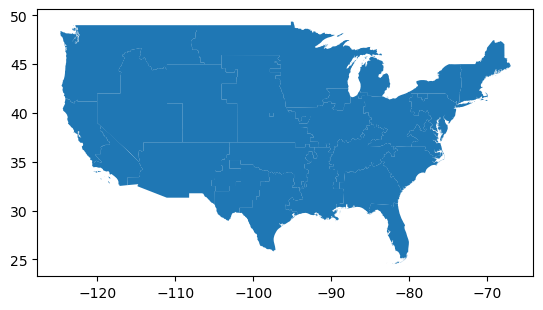

In [309]:
gdf = gpd.read_file("conus-26")
gdf["geometry"] = gdf.to_crs("EPSG:4326").simplify(0.01)
gdf = gdf.rename(columns={"model_regi": "zone"})
gdf.plot()

In [310]:
gdf.head()

,zone,region,geometry
0,BASN,WECC_ID,"POLYGON ((-114.04123 36.19409, -114.11587 36.1..."
1,CANO,WEC_BANC,"MULTIPOLYGON (((-122.36767 37.83451, -122.3532..."
2,CASO,WEC_LADW,"MULTIPOLYGON (((-119.53601 33.28967, -119.4570..."
3,FRCC,FRCC,"MULTIPOLYGON (((-82.87930 24.62696, -82.89094 ..."
4,ISNE,NENG_CT,"MULTIPOLYGON (((-73.63252 40.98728, -73.60212 ..."


In [311]:
tx_exp = pd.read_csv(data_folder / "annual_tx_expansion.csv")

In [313]:
gdf["lat"] = gdf.geometry.centroid.y
gdf["lon"] = gdf.geometry.centroid.x
tx_exp["lat1"] = tx_exp["start_region"].map(gdf.set_index("zone")["lat"])
tx_exp["lon1"] = tx_exp["start_region"].map(gdf.set_index("zone")["lon"])
tx_exp["lat2"] = tx_exp["dest_region"].map(gdf.set_index("zone")["lat"])
tx_exp["lon2"] = tx_exp["dest_region"].map(gdf.set_index("zone")["lon"])



by = ["line_name", "lat1", "lat2", "lon1", "lon2"]
_data = (
            tx_exp.query("planning_year >= 2025 and model=='GenX' and case=='full-base-200'")
            .groupby(by, as_index=False)[["value", "cap"]]
            .sum()
        )
lines = []
for idx, row in _data.iterrows():
    lines.append(LineString([[row["lon1"], row["lat1"]], [row["lon2"], row["lat2"]]]))
tx_exp_gdf = gpd.GeoDataFrame(_data, geometry=lines, crs="EPSG:4326")
tx_exp_gdf["cap"] /= 1000 # Convert to GW

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/2738163793.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["lat"] = gdf.geometry.centroid.y
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/2738163793.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["lon"] = gdf.geometry.centroid.x


In [314]:
tx_exp_gdf.head()

,line_name,lat1,lat2,lon1,lon2,value,cap,geometry
0,BASN_to_CANO,40.586107,38.611906,-114.459348,-121.383678,3562.0,0.002208,"LINESTRING (-114.45935 40.58611, -121.38368 38..."
1,BASN_to_CASO,40.586107,35.113245,-114.459348,-117.398780,1983.0,0.001884,"LINESTRING (-114.45935 40.58611, -117.39878 35..."
2,BASN_to_NWPP,40.586107,45.940213,-114.459348,-117.016703,4108.0,0.001917,"LINESTRING (-114.45935 40.58611, -117.01670 45..."
3,BASN_to_RMRG,40.586107,41.116790,-114.459348,-106.383752,2946980.0,1.992590,"LINESTRING (-114.45935 40.58611, -106.38375 41..."
4,BASN_to_SRSG,40.586107,34.348332,-114.459348,-109.307198,2707.0,0.002262,"LINESTRING (-114.45935 40.58611, -109.30720 34..."


In [315]:
ne_polygon = box(-88, 34, -72, 45)
ercot_polygon = box(-110, 26, -89, 42)

In [505]:
height = 160
width = 160

genx_cap_base = (
    cap.query("model == 'GenX' and case == 'full-base-200' and planning_year == 2050")
    .groupby(["zone", "tech_type"])["end_value"]
    .sum()
)
genx_cap_no_tx = (
    cap.query(
        "model == 'GenX' and case == 'full-base-200-tx-0' and planning_year == 2050"
    )
    .groupby(["zone", "tech_type"])["end_value"]
    .sum()
)
_gdf = gdf.set_index("zone")

model_figs = []
ne_figs = []
ercot_figs = []

ne_zones = ["NYUP", "NYCW", "PJME", "PJMW", "PJMD", "SRCA", "SRCE", "MISE"]
ne_labels = alt.Chart(_gdf.reset_index().clip(ne_polygon).query("zone in @ne_zones")).mark_text(
            dy=-6
        ).encode(
        longitude='lon:Q',
        latitude='lat:Q',
        text='zone:N',
        size=alt.value(8),
        opacity=alt.value(0.6),
        ).project(type="mercator")

ercot_zones = ["TRE", "TREW", "SRSG", "RMRG", "SPPC", "SPPS", "MISS", "MISC"]
ercot_labels = alt.Chart(_gdf.reset_index().clip(ercot_polygon).query("zone in @ercot_zones")).mark_text(
        dy=-6
    ).encode(
    longitude='lon:Q',
    latitude='lat:Q',
    text='zone:N',
    size=alt.value(8),
    opacity=alt.value(0.6),
    ).project(type="mercator")


for tech in ["CCS", "Solar", "Wind"]:
    tech_diff = genx_cap_base.loc[:, tech] - genx_cap_no_tx.loc[:, tech]
    _gdf["value"] = tech_diff / 1000 # Convert to GW
    _gdf["value"].fillna(0, inplace=True)


    if tech != "Solar":
        ercot_cap_chart = (
            alt.Chart(_gdf.clip(ercot_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start", color="white"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ercot_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_chart = (ercot_cap_chart + ercot_tx_chart).resolve_scale(color="independent")

        ne_cap_chart = (
            alt.Chart(_gdf.clip(ne_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ne_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_chart = (ne_cap_chart + ne_tx_chart).resolve_scale(color="independent")
        
    else:
        ercot_cap_chart = (
            alt.Chart(_gdf.clip(ercot_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start", color="white"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ercot_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )

        ercot_chart = (ercot_cap_chart + ercot_tx_chart).resolve_scale(color="independent")

        ne_cap_chart = (
            alt.Chart(_gdf.clip(ne_polygon), title=alt.Title(f"{tech}", orient="top", anchor="start"))
            .mark_geoshape(stroke="gray")
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_tx_chart = (
            alt.Chart(tx_exp_gdf.clip(ne_polygon))
            .mark_geoshape(strokeWidth=2, filled=False)
            .encode(
                color=alt.Color("cap:Q")
                .title(["Transmission", "Difference (GW)"])
                .scale(scheme="magma", reverse=True, domainMax=25, domainMin=0)
                # .legend(None)
            )
            .project(type="mercator")
            .properties(height=height, width=width)
        )
        
        ne_chart = (ne_cap_chart + ne_tx_chart).resolve_scale(color="independent")
    

    ercot_figs.append(ercot_chart + ercot_labels) 
    ne_figs.append(ne_chart + ne_labels)

    row_chart = alt.hconcat(
          ne_chart, ercot_chart
    )

    
        



    model_figs.append(
        row_chart
    )

# alt.vconcat(*model_figs).configure_legend(
#     gradientLength=100, gradientThickness=8
# ).configure_view(
#     continuousHeight=200,
#     continuousWidth=200,
#     strokeWidth=4,
#     fill='#FFEEDD',
#     stroke='red',
# )

/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1664297340.py:48: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  _gdf["value"].fillna(0, inplace=True)
/var/folders/nr/y3csklpd0l77v_k39y46s2rc0000gn/T/ipykernel_66065/1664297340.py:48: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behave

In [506]:
ne_chart_col = alt.vconcat(*ne_figs, spacing=5)
ne_chart_col

alt.VConcatChart(...)

In [508]:
(ne_chart_col.configure_legend(disable=True).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    )
    # .configure_legend(
    #     orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=2,
    #     labelFontSize=8,  # Legend labels
    #     titleFontSize=10  # Legend title
    # )
    .configure_header(title=None
    ).configure_title(fontSize=12))

alt.VConcatChart(...)

In [366]:
ne_chart_col.save("paper_transmission_cap_ne.pdf")
ne_chart_col.configure_legend(disable=True).save("paper_transmission_cap_ne_no_legend.pdf")

In [377]:
ercot_chart_col = alt.vconcat(*ercot_figs, spacing=5)
ercot_chart_col

alt.VConcatChart(...)

In [368]:
ercot_chart_col.save("paper_transmission_cap_ercot.pdf")
ercot_chart_col.configure_legend(disable=True).save("paper_transmission_cap_ercot_no_legend.pdf")

In [516]:
ne_ercot_chart_no_legend = alt.hconcat(
    ne_chart_col, ercot_chart_col, spacing=5
    ).configure_legend(
        disable=True
    ).configure_title(
        dy=8, fontSize=12
    ).configure_axis(
        labelFontSize=8,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_header(title=None
    )
ne_ercot_chart_no_legend

alt.HConcatChart(...)

In [517]:
ne_ercot_chart_no_legend.save("paper_transmission_cap_ne_ercot_no_legend_small_font.pdf")

In [ ]:
ne_polygon = box(-88, 34, -72, 45)
ercot_polygon = box(-110, 26, -89, 42)

In [400]:
ercot_polygon.bounds

(-110.0, 26.0, -89.0, 42.0)

In [413]:
xmin, ymin, xmax, ymax = (-110, 26, -89, 42)
# xmin, ymin, xmax, ymax = ercot_polygon.bounds
extent_roi_feature = {
    "type": "Feature",
    "geometry": {"type": "Polygon",
                 "coordinates": [[
                     [xmax, ymax],
                     [xmax, ymin],
                     [xmin, ymin],
                     [xmin, ymax],
                     [xmax, ymax]]]},
    "properties": {}
}

(
            alt.Chart(_gdf, title=alt.Title(f"{tech}", orient="top", anchor="start", color="white"))
            .mark_geoshape(stroke="gray", clip=True)
            .encode(
                color=alt.Color("value:Q")
                .title(["Capacity", "Difference (GW)"])
                .scale(scheme="purplegreen", domainMid=0, domainMax=50, domainMin=-50)
                .legend(None)
            )
            .project(type="mercator", fit=extent_roi_feature)
            .properties(height=height, width=width)
        )

alt.Chart(...)

### Hourly dispatch

In [4]:
from fig_functions import load_data, chart_dispatch
import pandas as pd
import geopandas as gpd
from shapely.geometry import box, LineString
import altair as alt
from pathlib import Path

alt.data_transformers.enable("vegafusion")

CWD = Path.cwd()

##### Net-zero

In [95]:
data_path = CWD.parent / "full-base-200"

In [96]:
dispatch = load_data(data_path, "dispatch.csv")

In [97]:
dispatch.loc[dispatch["agg_zone"] == "CA", "agg_zone"] = "WECC"

In [98]:
techs = ["Battery", "CCS", "Hydro", "Natural Gas CC", "Nuclear", "Wind"]
zones = ["WECC", "PJM", "TRE"]
data = dispatch.query("planning_year==2030 and tech_type in @techs and agg_zone in @zones").groupby(["model", "tech_type", "agg_zone", "hour"], as_index=False)[
    "value"
].sum()
data.loc[data["value"] < 10, "value"] = 0
chart = chart_dispatch(data).encode(row=alt.Row("az").title(None), column=alt.Column("tt").title(None)).properties(
    width=100, height=75
).configure_axis(
        labelFontSize=10,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=4,
        labelFontSize=10,  # Legend labels
        titleFontSize=12  # Legend title
    )
chart

alt.Chart(...)

In [99]:
chart.save("paper_dispatch_net_zero.pdf")

In [28]:
dispatch.hour.max()

np.int64(167)

##### Current policies

In [100]:
data_path = CWD.parent / "full-current-policies"

In [101]:
dispatch = load_data(data_path, "dispatch.csv")

In [102]:
dispatch.loc[dispatch["agg_zone"] == "CA", "agg_zone"] = "WECC"

In [103]:
techs = ["Battery", "Hydro", "Coal", "Natural Gas CC", "Nuclear", "Wind"]
zones = ["WECC", "PJM", "TRE"]
data = dispatch.query("planning_year==2030 and tech_type in @techs and agg_zone in @zones").groupby(["model", "tech_type", "agg_zone", "hour"], as_index=False)[
    "value"
].sum()
data.loc[data["value"] < 10, "value"] = 0
chart = chart_dispatch(data).encode(row=alt.Row("az").title(None), column=alt.Column("tt").title(None)).properties(
    width=100, height=75
).configure_axis(
        labelFontSize=10,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=4,
        labelFontSize=10,  # Legend labels
        titleFontSize=12  # Legend title
    )
chart

alt.Chart(...)

In [104]:
chart.save("paper_dispatch_current_policies.pdf")

##### Current policies unit commit

In [105]:
data_path = CWD.parent / "full-current-policies-commit"

In [106]:
dispatch = load_data(data_path, "dispatch.csv")

In [107]:
dispatch.loc[dispatch["agg_zone"] == "CA", "agg_zone"] = "WECC"

In [108]:
techs = ["Battery", "Hydro", "Coal", "Natural Gas CC", "Nuclear", "Wind"]
zones = ["WECC", "PJM", "TRE"]
data = dispatch.query("planning_year==2030 and tech_type in @techs and agg_zone in @zones").groupby(["model", "tech_type", "agg_zone", "hour"], as_index=False)[
    "value"
].sum()
data.loc[data["value"] < 10, "value"] = 0
chart = chart_dispatch(data).encode(row=alt.Row("az").title(None), column=alt.Column("tt").title(None)).properties(
    width=100, height=75
).configure_axis(
        labelFontSize=10,  # Axis labels
        titleFontSize=10  # Axis titles
    ).configure_legend(
        orient="bottom", strokeColor="#ccc", padding=4, cornerRadius=4, columns=4,
        labelFontSize=10,  # Legend labels
        titleFontSize=12  # Legend title
    )
chart

alt.Chart(...)

In [109]:
chart.save("paper_dispatch_current_policies_commit.pdf")